# Implementing a Neural Network
In this exercise we will develop a neural network with fully-connected layers to perform classification, and test it out on the CIFAR-10 dataset.

In [1]:
# A bit of setup

import numpy as np
import matplotlib.pyplot as plt

from cs231n.classifiers.neural_net import TwoLayerNet

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
  #print np.abs(x-y)
  #print np.abs(x) + np.abs(y)
  """ returns relative error """
  return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

We will use the class `TwoLayerNet` in the file `cs231n/classifiers/neural_net.py` to represent instances of our network. The network parameters are stored in the instance variable `self.params` where keys are string parameter names and values are numpy arrays. Below, we initialize toy data and a toy model that we will use to develop your implementation.

In [2]:
# Create a small net and some toy data to check your implementations.
# Note that we set the random seed for repeatable experiments.

input_size = 4
hidden_size = 10
num_classes = 3
num_inputs = 5

def init_toy_model():
  np.random.seed(0)
  return TwoLayerNet(input_size, hidden_size, num_classes, std=1e-1)

def init_toy_data():
  np.random.seed(1)
  X = 10 * np.random.randn(num_inputs, input_size)
  y = np.array([0, 1, 2, 2, 1])
  return X, y

net = init_toy_model()
X, y = init_toy_data()

# Forward pass: compute scores
Open the file `cs231n/classifiers/neural_net.py` and look at the method `TwoLayerNet.loss`. This function is very similar to the loss functions you have written for the SVM and Softmax exercises: It takes the data and weights and computes the class scores, the loss, and the gradients on the parameters. 

Implement the first part of the forward pass which uses the weights and biases to compute the scores for all inputs.

In [3]:
scores = net.loss(X)
print 'Your scores:'
print scores
print
print 'correct scores:'
correct_scores = np.asarray([
  [-0.81233741, -1.27654624, -0.70335995],
  [-0.17129677, -1.18803311, -0.47310444],
  [-0.51590475, -1.01354314, -0.8504215 ],
  [-0.15419291, -0.48629638, -0.52901952],
  [-0.00618733, -0.12435261, -0.15226949]])
print correct_scores
print

# The difference should be very small. We get < 1e-7
print 'Difference between your scores and correct scores:'
print np.sum(np.abs(scores - correct_scores))

Your scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

correct scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

Difference between your scores and correct scores:
3.68027207103e-08


# Forward pass: compute loss
In the same function, implement the second part that computes the data and regularizaion loss.

In [4]:
loss, _ = net.loss(X, y, reg=0.1)
correct_loss = 1.30378789133

# should be very small, we get < 1e-12
print 'Difference between your loss and correct loss:'
print np.sum(np.abs(loss - correct_loss))

Difference between your loss and correct loss:
1.79412040779e-13


# Backward pass
Implement the rest of the function. This will compute the gradient of the loss with respect to the variables `W1`, `b1`, `W2`, and `b2`. Now that you (hopefully!) have a correctly implemented forward pass, you can debug your backward pass using a numeric gradient check:

In [5]:
from cs231n.gradient_check import eval_numerical_gradient

# Use numeric gradient checking to check your implementation of the backward pass.
# If your implementation is correct, the difference between the numeric and
# analytic gradients should be less than 1e-8 for each of W1, W2, b1, and b2.

loss, grads = net.loss(X, y, reg=0.1)

# these should all be less than 1e-8 or so
for param_name in grads:
  f = lambda W: net.loss(X, y, reg=0.1)[0]
  param_grad_num = eval_numerical_gradient(f, net.params[param_name], verbose=False)
  print '%s max relative error: %e' % (param_name, rel_error(param_grad_num, grads[param_name]))

W1 max relative error: 3.561318e-09
W2 max relative error: 3.440708e-09
b2 max relative error: 4.447625e-11
b1 max relative error: 2.738421e-09


# Train the network
To train the network we will use stochastic gradient descent (SGD), similar to the SVM and Softmax classifiers. Look at the function `TwoLayerNet.train` and fill in the missing sections to implement the training procedure. This should be very similar to the training procedure you used for the SVM and Softmax classifiers. You will also have to implement `TwoLayerNet.predict`, as the training process periodically performs prediction to keep track of accuracy over time while the network trains.

Once you have implemented the method, run the code below to train a two-layer network on toy data. You should achieve a training loss less than 0.2.

Final training loss:  0.0171496079387


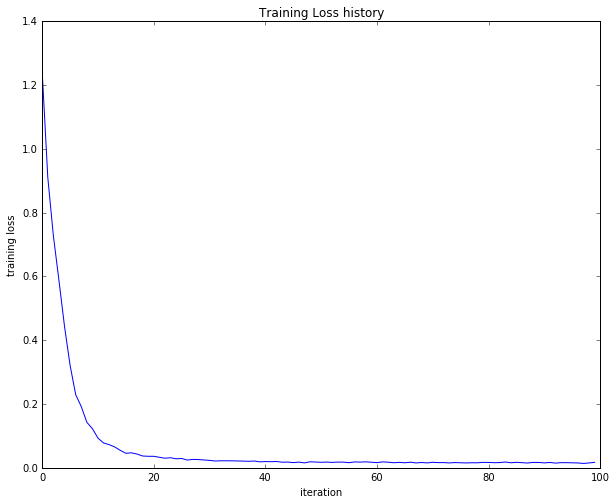

In [6]:
net = init_toy_model()
stats = net.train(X, y, X, y,
            learning_rate=1e-1, reg=1e-5,
            num_iters=100, verbose=False)

print 'Final training loss: ', stats['loss_history'][-1]

# plot the loss history
plt.plot(stats['loss_history'])
plt.xlabel('iteration')
plt.ylabel('training loss')
plt.title('Training Loss history')
plt.show()

# Load the data
Now that you have implemented a two-layer network that passes gradient checks and works on toy data, it's time to load up our favorite CIFAR-10 data so we can use it to train a classifier on a real dataset.

In [7]:
from cs231n.data_utils import load_CIFAR10

def get_CIFAR10_data(num_training=49000, num_validation=1000, num_test=1000):
    """
    Load the CIFAR-10 dataset from disk and perform preprocessing to prepare
    it for the two-layer neural net classifier. These are the same steps as
    we used for the SVM, but condensed to a single function.  
    """
    # Load the raw CIFAR-10 data
    cifar10_dir = 'cs231n/datasets/cifar-10-batches-py'
    X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)
        
    # Subsample the data
    mask = range(num_training, num_training + num_validation)
    X_val = X_train[mask]
    y_val = y_train[mask]
    mask = range(num_training)
    X_train = X_train[mask]
    y_train = y_train[mask]
    mask = range(num_test)
    X_test = X_test[mask]
    y_test = y_test[mask]

    # Normalize the data: subtract the mean image
    mean_image = np.mean(X_train, axis=0)
    X_train -= mean_image
    X_val -= mean_image
    X_test -= mean_image

    # Reshape data to rows
    X_train = X_train.reshape(num_training, -1)
    X_val = X_val.reshape(num_validation, -1)
    X_test = X_test.reshape(num_test, -1)

    return X_train, y_train, X_val, y_val, X_test, y_test


# Invoke the above function to get our data.
X_train, y_train, X_val, y_val, X_test, y_test = get_CIFAR10_data()
print 'Train data shape: ', X_train.shape
print 'Train labels shape: ', y_train.shape
print 'Validation data shape: ', X_val.shape
print 'Validation labels shape: ', y_val.shape
print 'Test data shape: ', X_test.shape
print 'Test labels shape: ', y_test.shape

Train data shape:  (49000, 3072)
Train labels shape:  (49000,)
Validation data shape:  (1000, 3072)
Validation labels shape:  (1000,)
Test data shape:  (1000, 3072)
Test labels shape:  (1000,)


# Train a network
To train our network we will use SGD with momentum. In addition, we will adjust the learning rate with an exponential learning rate schedule as optimization proceeds; after each epoch, we will reduce the learning rate by multiplying it by a decay rate.

In [8]:
input_size = 32 * 32 * 3
hidden_size = 50
num_classes = 10
net = TwoLayerNet(input_size, hidden_size, num_classes)

# Train the network
stats = net.train(X_train, y_train, X_val, y_val,
            num_iters=1000, batch_size=200,
            learning_rate=1e-4, learning_rate_decay=0.95,
            reg=0.5, verbose=True)

# Predict on the validation set
val_acc = (net.predict(X_val) == y_val).mean()
print 'Validation accuracy: ', val_acc

iteration 0 / 1000: loss 2.302954
iteration 100 / 1000: loss 2.302550
iteration 200 / 1000: loss 2.297648
iteration 300 / 1000: loss 2.259602
iteration 400 / 1000: loss 2.204170
iteration 500 / 1000: loss 2.118565
iteration 600 / 1000: loss 2.051535
iteration 700 / 1000: loss 1.988466
iteration 800 / 1000: loss 2.006591
iteration 900 / 1000: loss 1.951473
Validation accuracy:  0.287


# Debug the training
With the default parameters we provided above, you should get a validation accuracy of about 0.29 on the validation set. This isn't very good.

One strategy for getting insight into what's wrong is to plot the loss function and the accuracies on the training and validation sets during optimization.

Another strategy is to visualize the weights that were learned in the first layer of the network. In most neural networks trained on visual data, the first layer weights typically show some visible structure when visualized.

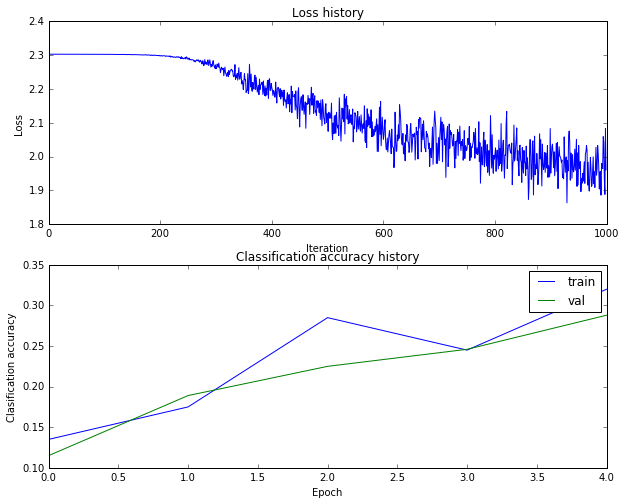

In [9]:
# Plot the loss function and train / validation accuracies
plt.subplot(2, 1, 1)
plt.plot(stats['loss_history'])
plt.title('Loss history')
plt.xlabel('Iteration')
plt.ylabel('Loss')

plt.subplot(2, 1, 2)
plt.plot(stats['train_acc_history'], label='train')
plt.plot(stats['val_acc_history'], label='val')
plt.title('Classification accuracy history')
plt.xlabel('Epoch')
plt.ylabel('Clasification accuracy')
plt.legend()
plt.show()

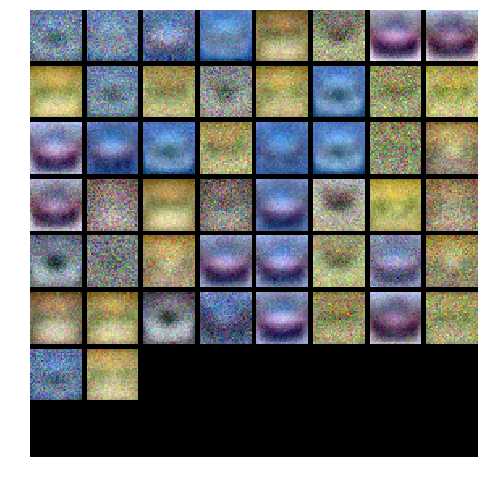

In [10]:
from cs231n.vis_utils import visualize_grid

# Visualize the weights of the network

def show_net_weights(net):
  W1 = net.params['W1']
  W1 = W1.reshape(32, 32, 3, -1).transpose(3, 0, 1, 2)
  plt.imshow(visualize_grid(W1, padding=3).astype('uint8'))
  plt.gca().axis('off')
  plt.show()

show_net_weights(net)

# Tune your hyperparameters

**What's wrong?**. Looking at the visualizations above, we see that the loss is decreasing more or less linearly, which seems to suggest that the learning rate may be too low. Moreover, there is no gap between the training and validation accuracy, suggesting that the model we used has low capacity, and that we should increase its size. On the other hand, with a very large model we would expect to see more overfitting, which would manifest itself as a very large gap between the training and validation accuracy.

**Tuning**. Tuning the hyperparameters and developing intuition for how they affect the final performance is a large part of using Neural Networks, so we want you to get a lot of practice. Below, you should experiment with different values of the various hyperparameters, including hidden layer size, learning rate, numer of training epochs, and regularization strength. You might also consider tuning the learning rate decay, but you should be able to get good performance using the default value.

**Approximate results**. You should be aim to achieve a classification accuracy of greater than 48% on the validation set. Our best network gets over 52% on the validation set.

**Experiment**: You goal in this exercise is to get as good of a result on CIFAR-10 as you can, with a fully-connected Neural Network. For every 1% above 52% on the Test set we will award you with one extra bonus point. Feel free implement your own techniques (e.g. PCA to reduce dimensionality, or adding dropout, or adding features to the solver, etc.).

Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.302662
iteration 100 / 3000: loss 1.979236
iteration 200 / 3000: loss 1.756309
iteration 300 / 3000: loss 1.828609
iteration 400 / 3000: loss 1.669977
iteration 500 / 3000: loss 1.705944
iteration 600 / 3000: loss 1.575538
iteration 700 / 3000: loss 1.579042
iteration 800 / 3000: loss 1.508872
iteration 900 / 3000: loss 1.581891
iteration 1000 / 3000: loss 1.451624
iteration 1100 / 3000: loss 1.405991
iteration 1200 / 3000: loss 1.439240
iteration 1300 / 3000: loss 1.449446
iteration 1400 / 3000: loss 1.426749
iteration 1500 / 3000: loss 1.385142
iteration 1600 / 3000: loss 1.383961
iteration 1700 / 3000: loss 1.438768
iteration 1800 / 3000: loss 1.317934
iteration 1900 / 3000: loss 1.457506
iteration 2000 / 3000: loss 1.386446
iteration 2100 / 3000: loss 1.28201

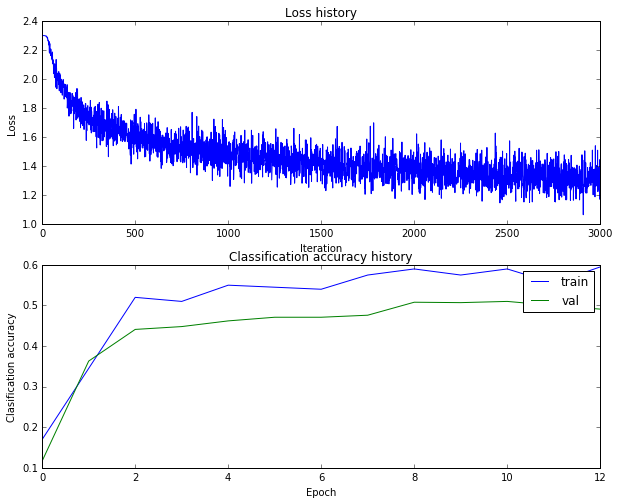

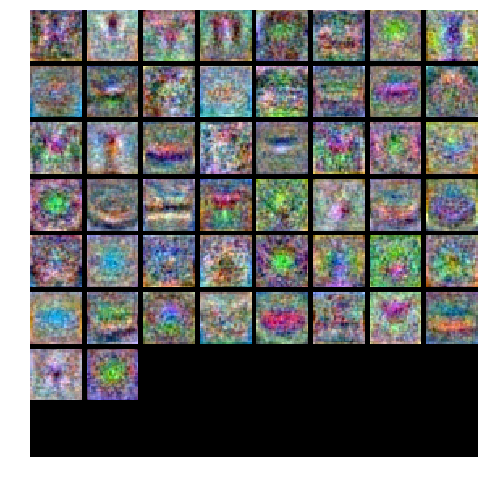

Validation accuracy:  0.511
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.302671
iteration 100 / 3000: loss 1.970229
iteration 200 / 3000: loss 1.774172
iteration 300 / 3000: loss 1.735471
iteration 400 / 3000: loss 1.641663
iteration 500 / 3000: loss 1.623251
iteration 600 / 3000: loss 1.509050
iteration 700 / 3000: loss 1.539019
iteration 800 / 3000: loss 1.461297
iteration 900 / 3000: loss 1.529588
iteration 1000 / 3000: loss 1.492676
iteration 1100 / 3000: loss 1.407957
iteration 1200 / 3000: loss 1.491981
iteration 1300 / 3000: loss 1.586797
iteration 1400 / 3000: loss 1.407589
iteration 1500 / 3000: loss 1.363679
iteration 1600 / 3000: loss 1.470922
iteration 1700 / 3000: loss 1.326872
iteration 1800 / 3000: loss 1.310416
iteration 1900 / 3000: loss 1.324225
iteration 2000 / 3000: loss 1.416025
iterati

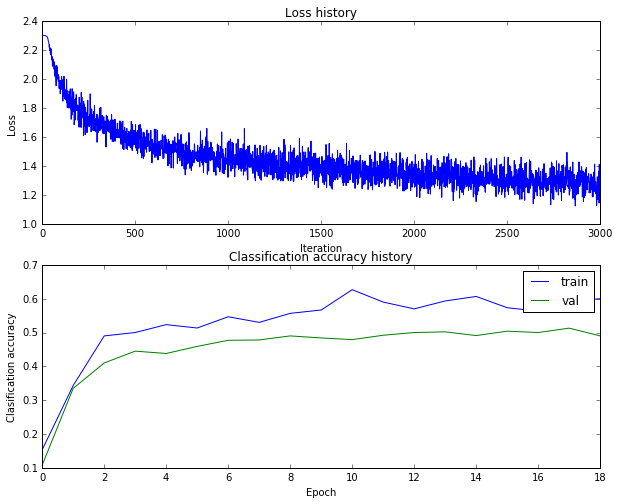

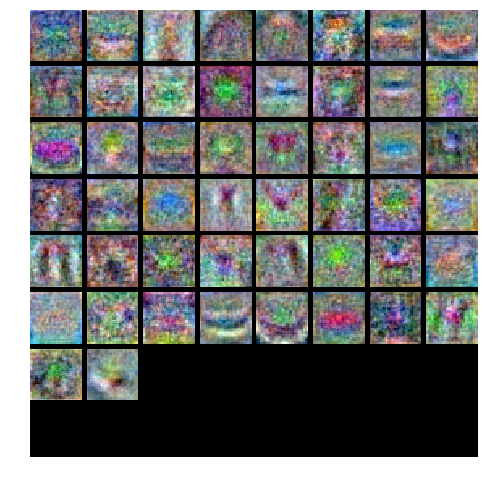

Validation accuracy:  0.504
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.302663
iteration 100 / 3000: loss 1.990991
iteration 200 / 3000: loss 1.748850
iteration 300 / 3000: loss 1.702267
iteration 400 / 3000: loss 1.639956
iteration 500 / 3000: loss 1.613409
iteration 600 / 3000: loss 1.506790
iteration 700 / 3000: loss 1.472896
iteration 800 / 3000: loss 1.554426
iteration 900 / 3000: loss 1.565069
iteration 1000 / 3000: loss 1.459000
iteration 1100 / 3000: loss 1.446489
iteration 1200 / 3000: loss 1.427218
iteration 1300 / 3000: loss 1.365061
iteration 1400 / 3000: loss 1.400442
iteration 1500 / 3000: loss 1.396865
iteration 1600 / 3000: loss 1.289080
iteration 1700 / 3000: loss 1.349227
iteration 1800 / 3000: loss 1.444937
iteration 1900 / 3000: loss 1.356845
iteration 2000 / 3000: loss 1.362681
iterati

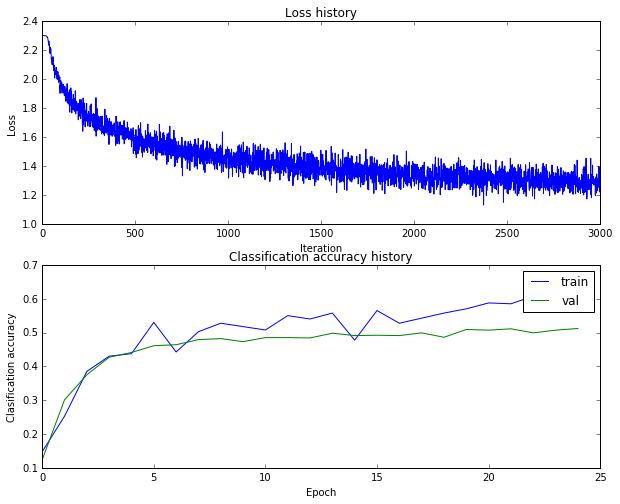

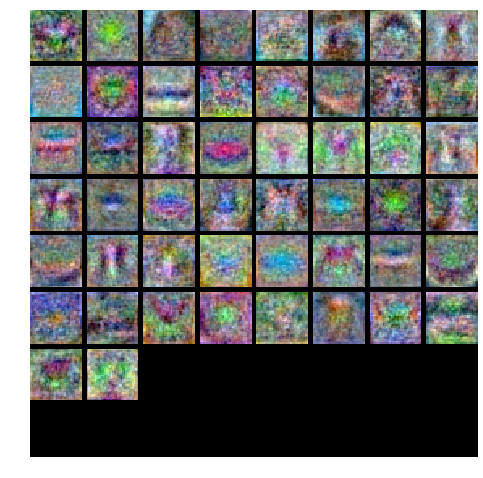

Validation accuracy:  0.51
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.302691
iteration 100 / 3000: loss 1.972633
iteration 200 / 3000: loss 1.810217
iteration 300 / 3000: loss 1.719571
iteration 400 / 3000: loss 1.687076
iteration 500 / 3000: loss 1.575419
iteration 600 / 3000: loss 1.645596
iteration 700 / 3000: loss 1.522846
iteration 800 / 3000: loss 1.575829
iteration 900 / 3000: loss 1.576356
iteration 1000 / 3000: loss 1.431094
iteration 1100 / 3000: loss 1.406645
iteration 1200 / 3000: loss 1.390947
iteration 1300 / 3000: loss 1.332370
iteration 1400 / 3000: loss 1.476612
iteration 1500 / 3000: loss 1.322987
iteration 1600 / 3000: loss 1.503711
iteration 1700 / 3000: loss 1.363319
iteration 1800 / 3000: loss 1.313549
iteration 1900 / 3000: loss 1.350784
iteration 2000 / 3000: loss 1.281219
iteratio

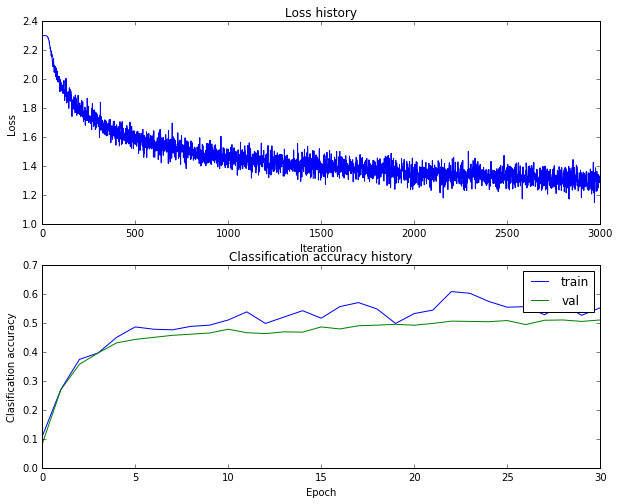

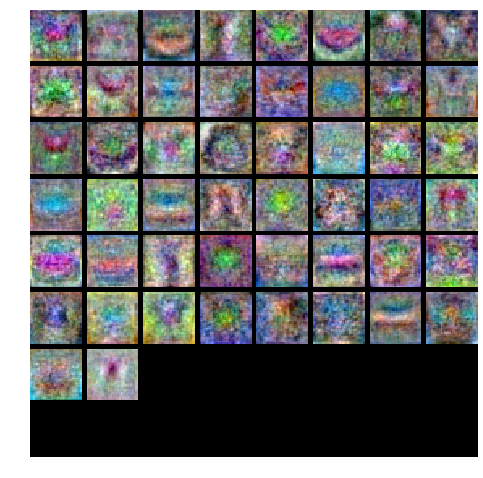

Validation accuracy:  0.51
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 3000
                           and batch size = 600
iteration 0 / 3000: loss 2.302653
iteration 100 / 3000: loss 1.932437
iteration 200 / 3000: loss 1.789327
iteration 300 / 3000: loss 1.655574
iteration 400 / 3000: loss 1.600797
iteration 500 / 3000: loss 1.562053
iteration 600 / 3000: loss 1.595728
iteration 700 / 3000: loss 1.565783
iteration 800 / 3000: loss 1.512049
iteration 900 / 3000: loss 1.433598
iteration 1000 / 3000: loss 1.513494
iteration 1100 / 3000: loss 1.470891
iteration 1200 / 3000: loss 1.463088
iteration 1300 / 3000: loss 1.414655
iteration 1400 / 3000: loss 1.444698
iteration 1500 / 3000: loss 1.373341
iteration 1600 / 3000: loss 1.412190
iteration 1700 / 3000: loss 1.414893
iteration 1800 / 3000: loss 1.365178
iteration 1900 / 3000: loss 1.403526
iteration 2000 / 3000: loss 1.391646
iteratio

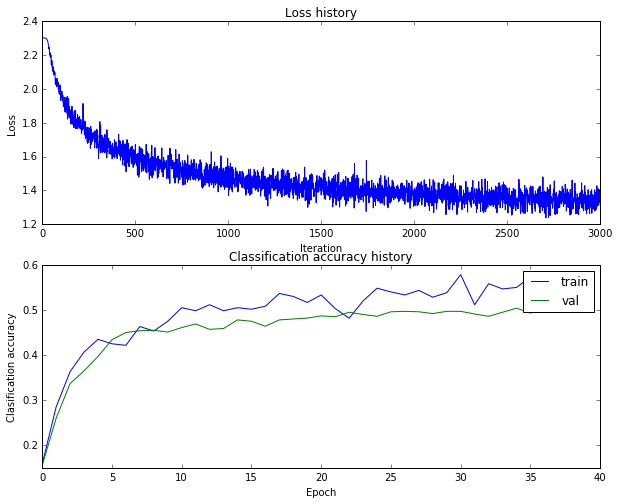

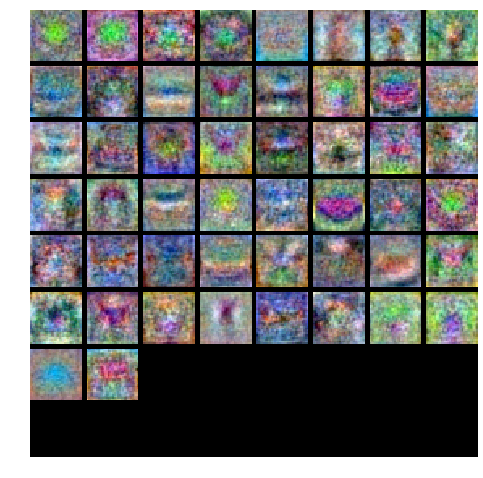

Validation accuracy:  0.51
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 5000
                           and batch size = 200
iteration 0 / 5000: loss 2.302643
iteration 100 / 5000: loss 1.938176
iteration 200 / 5000: loss 1.773315
iteration 300 / 5000: loss 1.648055
iteration 400 / 5000: loss 1.685599
iteration 500 / 5000: loss 1.630195
iteration 600 / 5000: loss 1.635108
iteration 700 / 5000: loss 1.536688
iteration 800 / 5000: loss 1.420593
iteration 900 / 5000: loss 1.409703
iteration 1000 / 5000: loss 1.483363
iteration 1100 / 5000: loss 1.529852
iteration 1200 / 5000: loss 1.473282
iteration 1300 / 5000: loss 1.324788
iteration 1400 / 5000: loss 1.485397
iteration 1500 / 5000: loss 1.495415
iteration 1600 / 5000: loss 1.407748
iteration 1700 / 5000: loss 1.467486
iteration 1800 / 5000: loss 1.311034
iteration 1900 / 5000: loss 1.464955
iteration 2000 / 5000: loss 1.298227
iteratio

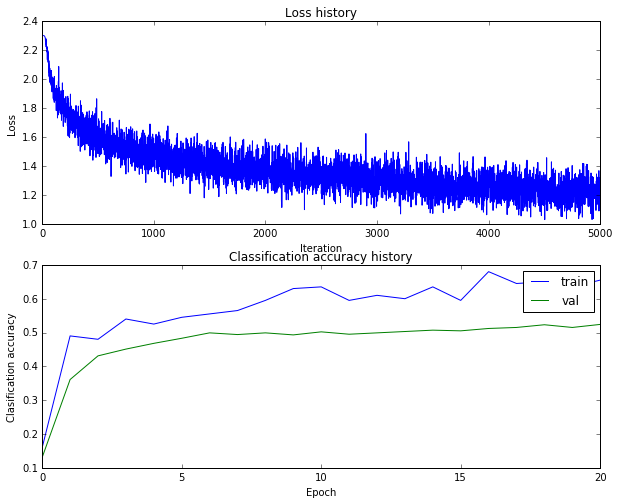

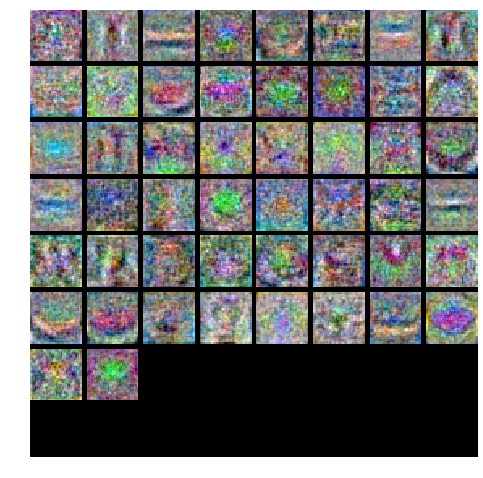

Validation accuracy:  0.519
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 5000
                           and batch size = 300
iteration 0 / 5000: loss 2.302661
iteration 100 / 5000: loss 1.953839
iteration 200 / 5000: loss 1.783797
iteration 300 / 5000: loss 1.641110
iteration 400 / 5000: loss 1.644445
iteration 500 / 5000: loss 1.549877
iteration 600 / 5000: loss 1.566713
iteration 700 / 5000: loss 1.450020
iteration 800 / 5000: loss 1.560546
iteration 900 / 5000: loss 1.464811
iteration 1000 / 5000: loss 1.501451
iteration 1100 / 5000: loss 1.504144
iteration 1200 / 5000: loss 1.538956
iteration 1300 / 5000: loss 1.332310
iteration 1400 / 5000: loss 1.333237
iteration 1500 / 5000: loss 1.342881
iteration 1600 / 5000: loss 1.382950
iteration 1700 / 5000: loss 1.311361
iteration 1800 / 5000: loss 1.379467
iteration 1900 / 5000: loss 1.316986
iteration 2000 / 5000: loss 1.230163
iterati

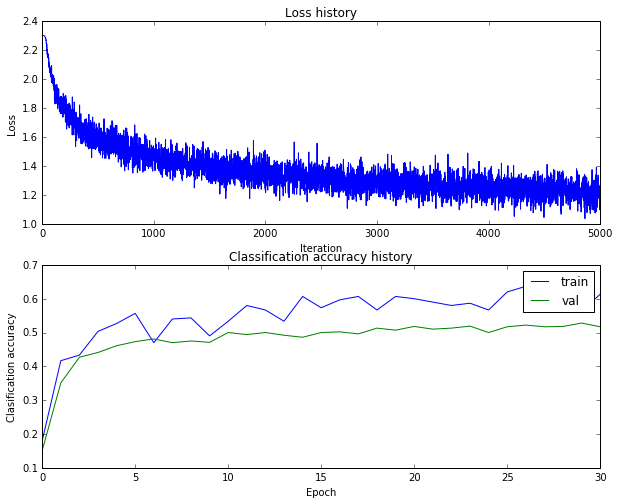

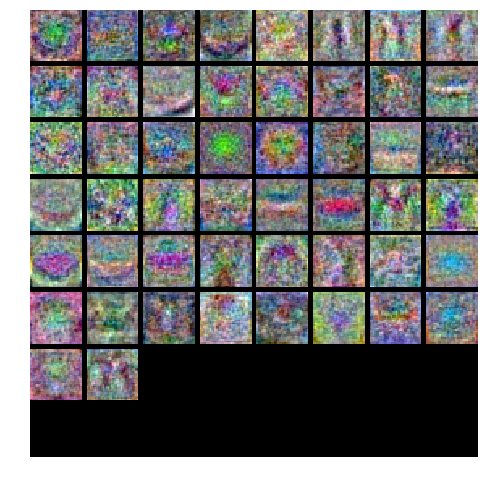

Validation accuracy:  0.53
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 5000
                           and batch size = 400
iteration 0 / 5000: loss 2.302643
iteration 100 / 5000: loss 2.008340
iteration 200 / 5000: loss 1.800322
iteration 300 / 5000: loss 1.742255
iteration 400 / 5000: loss 1.645074
iteration 500 / 5000: loss 1.580928
iteration 600 / 5000: loss 1.649188
iteration 700 / 5000: loss 1.476365
iteration 800 / 5000: loss 1.522055
iteration 900 / 5000: loss 1.476521
iteration 1000 / 5000: loss 1.397078
iteration 1100 / 5000: loss 1.508238
iteration 1200 / 5000: loss 1.493455
iteration 1300 / 5000: loss 1.418133
iteration 1400 / 5000: loss 1.517476
iteration 1500 / 5000: loss 1.362110
iteration 1600 / 5000: loss 1.359447
iteration 1700 / 5000: loss 1.315112
iteration 1800 / 5000: loss 1.396448
iteration 1900 / 5000: loss 1.386339
iteration 2000 / 5000: loss 1.406051
iteratio

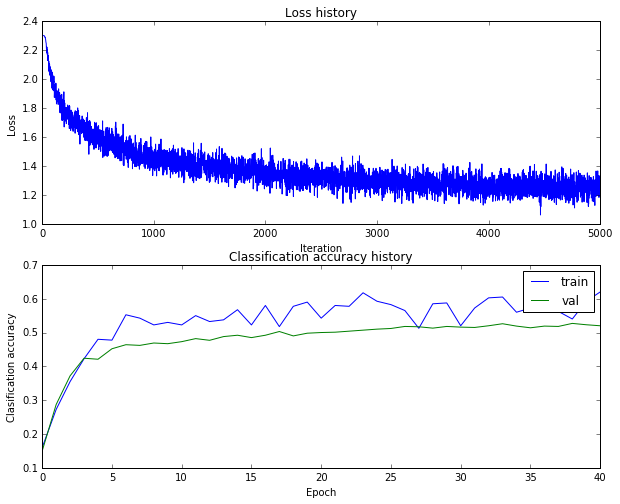

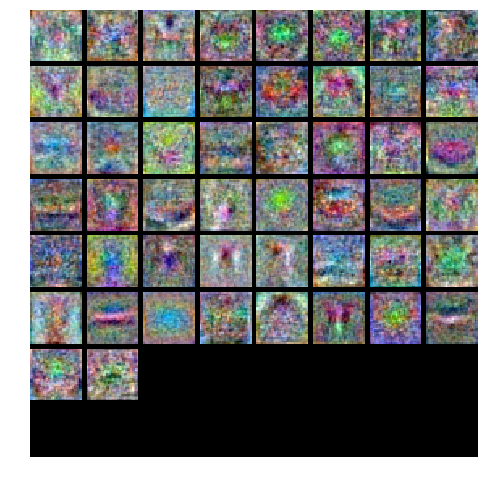

Validation accuracy:  0.515
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 5000
                           and batch size = 500
iteration 0 / 5000: loss 2.302655
iteration 100 / 5000: loss 1.974759
iteration 200 / 5000: loss 1.840655
iteration 300 / 5000: loss 1.640552
iteration 400 / 5000: loss 1.604929
iteration 500 / 5000: loss 1.624082
iteration 600 / 5000: loss 1.489505
iteration 700 / 5000: loss 1.520141
iteration 800 / 5000: loss 1.533750
iteration 900 / 5000: loss 1.388916
iteration 1000 / 5000: loss 1.472217
iteration 1100 / 5000: loss 1.482191
iteration 1200 / 5000: loss 1.459425
iteration 1300 / 5000: loss 1.383430
iteration 1400 / 5000: loss 1.372762
iteration 1500 / 5000: loss 1.408044
iteration 1600 / 5000: loss 1.454450
iteration 1700 / 5000: loss 1.364911
iteration 1800 / 5000: loss 1.372137
iteration 1900 / 5000: loss 1.350903
iteration 2000 / 5000: loss 1.313247
iterati

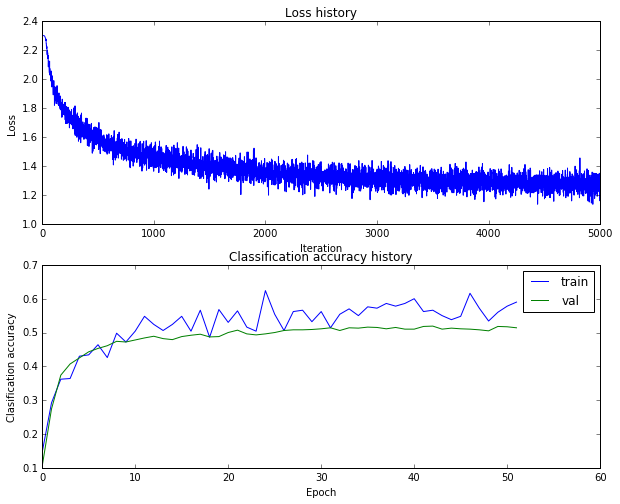

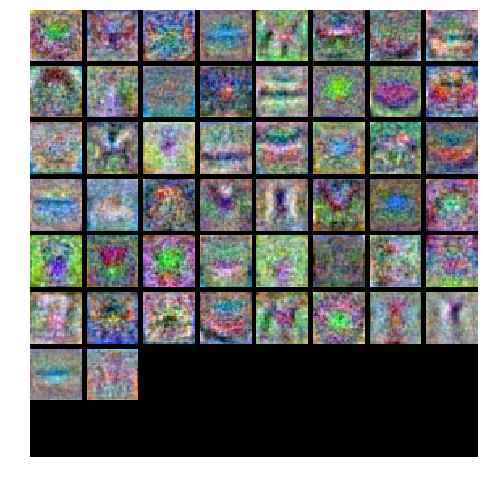

Validation accuracy:  0.516
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 5000
                           and batch size = 600
iteration 0 / 5000: loss 2.302652
iteration 100 / 5000: loss 1.951775
iteration 200 / 5000: loss 1.836952
iteration 300 / 5000: loss 1.647490
iteration 400 / 5000: loss 1.608140
iteration 500 / 5000: loss 1.662892
iteration 600 / 5000: loss 1.516757
iteration 700 / 5000: loss 1.479160
iteration 800 / 5000: loss 1.563521
iteration 900 / 5000: loss 1.452924
iteration 1000 / 5000: loss 1.530360
iteration 1100 / 5000: loss 1.431573
iteration 1200 / 5000: loss 1.389009
iteration 1300 / 5000: loss 1.356887
iteration 1400 / 5000: loss 1.524655
iteration 1500 / 5000: loss 1.391995
iteration 1600 / 5000: loss 1.471299
iteration 1700 / 5000: loss 1.362191
iteration 1800 / 5000: loss 1.345103
iteration 1900 / 5000: loss 1.403738
iteration 2000 / 5000: loss 1.285456
iterati

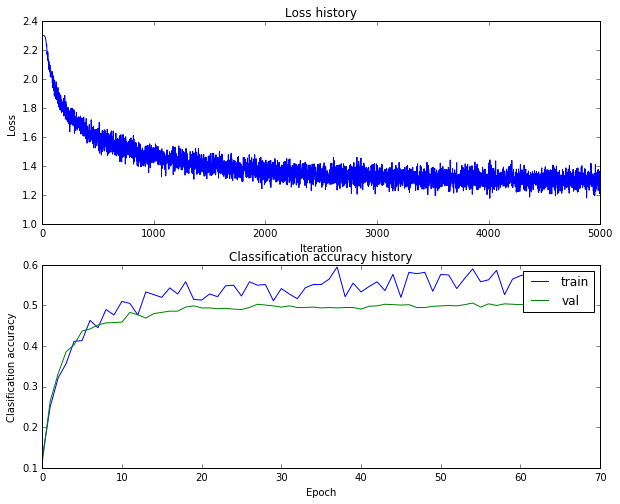

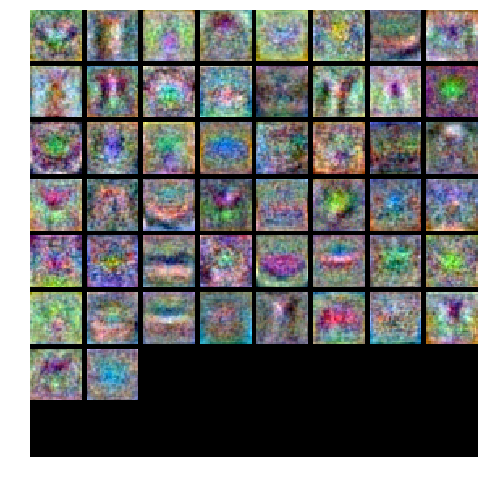

Validation accuracy:  0.501
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.302750
iteration 100 / 3000: loss 1.922952
iteration 200 / 3000: loss 1.750956
iteration 300 / 3000: loss 1.760093
iteration 400 / 3000: loss 1.693115
iteration 500 / 3000: loss 1.577843
iteration 600 / 3000: loss 1.537515
iteration 700 / 3000: loss 1.597235
iteration 800 / 3000: loss 1.454996
iteration 900 / 3000: loss 1.458448
iteration 1000 / 3000: loss 1.195425
iteration 1100 / 3000: loss 1.377620
iteration 1200 / 3000: loss 1.378453
iteration 1300 / 3000: loss 1.246428
iteration 1400 / 3000: loss 1.542353
iteration 1500 / 3000: loss 1.278076
iteration 1600 / 3000: loss 1.287963
iteration 1700 / 3000: loss 1.329078
iteration 1800 / 3000: loss 1.227392
iteration 1900 / 3000: loss 1.252209
iteration 2000 / 3000: loss 1.322457
iterat

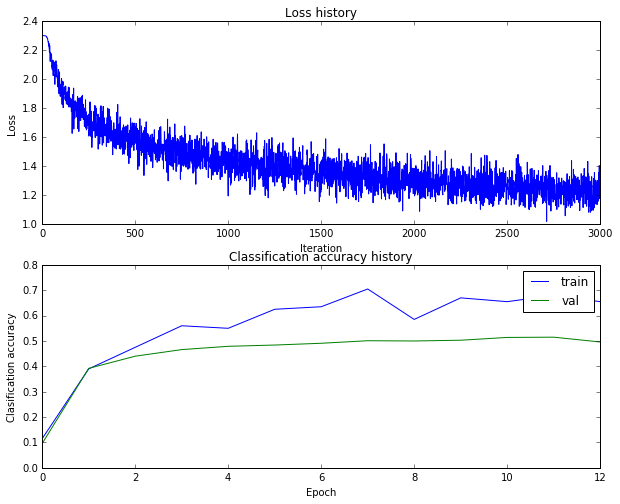

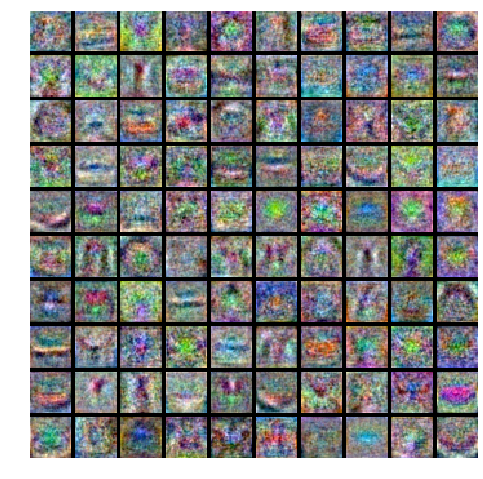

Validation accuracy:  0.506
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.302720
iteration 100 / 3000: loss 1.945252
iteration 200 / 3000: loss 1.662767
iteration 300 / 3000: loss 1.697210
iteration 400 / 3000: loss 1.743157
iteration 500 / 3000: loss 1.470697
iteration 600 / 3000: loss 1.631354
iteration 700 / 3000: loss 1.465288
iteration 800 / 3000: loss 1.576526
iteration 900 / 3000: loss 1.468962
iteration 1000 / 3000: loss 1.422242
iteration 1100 / 3000: loss 1.500197
iteration 1200 / 3000: loss 1.271762
iteration 1300 / 3000: loss 1.455127
iteration 1400 / 3000: loss 1.304741
iteration 1500 / 3000: loss 1.396287
iteration 1600 / 3000: loss 1.268822
iteration 1700 / 3000: loss 1.432049
iteration 1800 / 3000: loss 1.217889
iteration 1900 / 3000: loss 1.348725
iteration 2000 / 3000: loss 1.406122
iterat

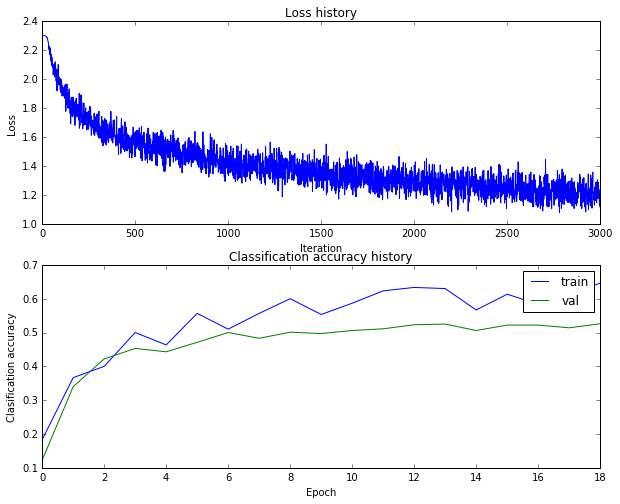

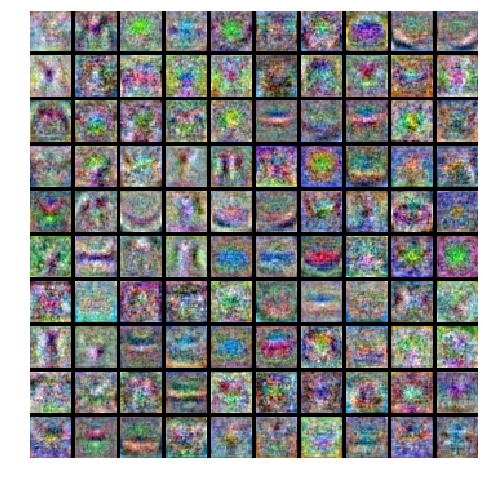

Validation accuracy:  0.508
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.302749
iteration 100 / 3000: loss 1.942030
iteration 200 / 3000: loss 1.802320
iteration 300 / 3000: loss 1.657909
iteration 400 / 3000: loss 1.599106
iteration 500 / 3000: loss 1.599989
iteration 600 / 3000: loss 1.518560
iteration 700 / 3000: loss 1.430643
iteration 800 / 3000: loss 1.536048
iteration 900 / 3000: loss 1.492162
iteration 1000 / 3000: loss 1.414896
iteration 1100 / 3000: loss 1.396955
iteration 1200 / 3000: loss 1.541516
iteration 1300 / 3000: loss 1.373556
iteration 1400 / 3000: loss 1.368006
iteration 1500 / 3000: loss 1.441856
iteration 1600 / 3000: loss 1.355019
iteration 1700 / 3000: loss 1.325751
iteration 1800 / 3000: loss 1.334113
iteration 1900 / 3000: loss 1.291653
iteration 2000 / 3000: loss 1.400511
iterat

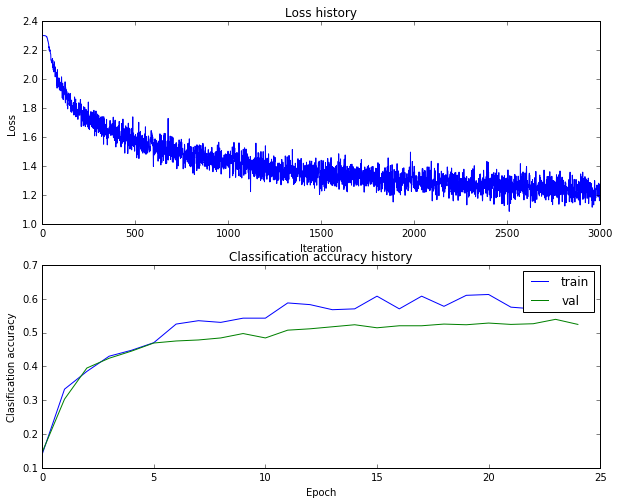

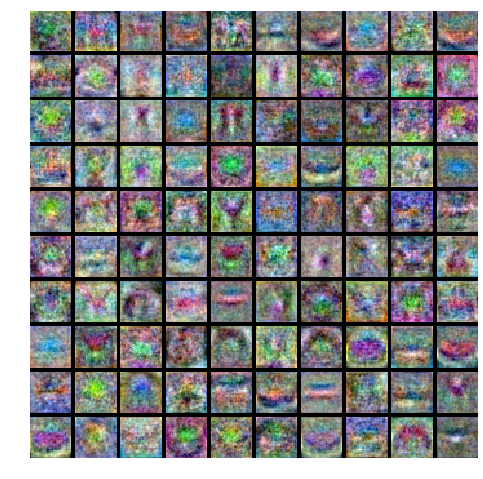

Validation accuracy:  0.525
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.302729
iteration 100 / 3000: loss 1.966437
iteration 200 / 3000: loss 1.793771
iteration 300 / 3000: loss 1.682180
iteration 400 / 3000: loss 1.581630
iteration 500 / 3000: loss 1.473290
iteration 600 / 3000: loss 1.495248
iteration 700 / 3000: loss 1.456497
iteration 800 / 3000: loss 1.450766
iteration 900 / 3000: loss 1.468881
iteration 1000 / 3000: loss 1.431501
iteration 1100 / 3000: loss 1.535207
iteration 1200 / 3000: loss 1.377742
iteration 1300 / 3000: loss 1.347818
iteration 1400 / 3000: loss 1.413712
iteration 1500 / 3000: loss 1.333895
iteration 1600 / 3000: loss 1.401109
iteration 1700 / 3000: loss 1.339837
iteration 1800 / 3000: loss 1.290529
iteration 1900 / 3000: loss 1.291773
iteration 2000 / 3000: loss 1.370437
iterat

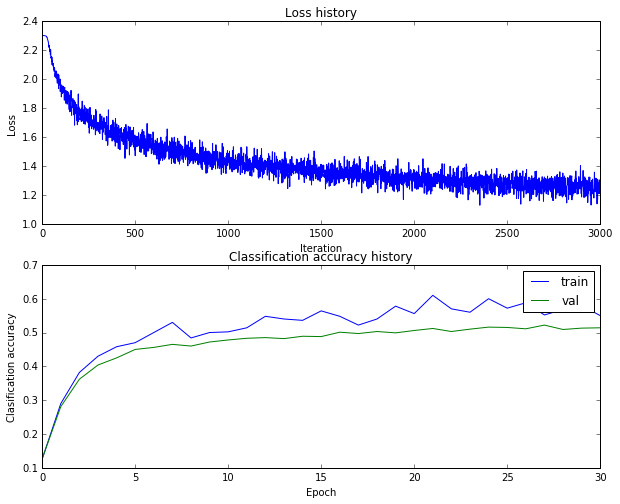

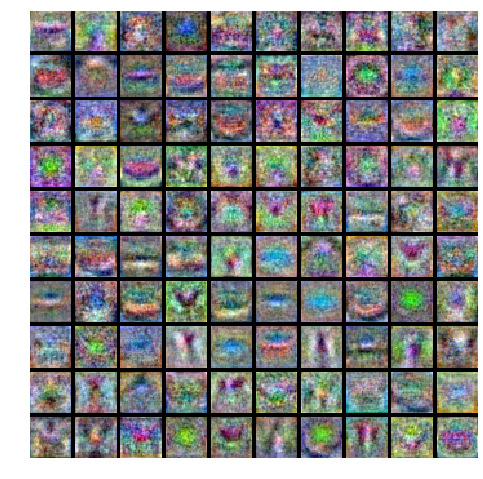

Validation accuracy:  0.519
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 3000
                           and batch size = 600
iteration 0 / 3000: loss 2.302763
iteration 100 / 3000: loss 1.970044
iteration 200 / 3000: loss 1.843711
iteration 300 / 3000: loss 1.691370
iteration 400 / 3000: loss 1.636660
iteration 500 / 3000: loss 1.567918
iteration 600 / 3000: loss 1.555618
iteration 700 / 3000: loss 1.547712
iteration 800 / 3000: loss 1.478416
iteration 900 / 3000: loss 1.438218
iteration 1000 / 3000: loss 1.390827
iteration 1100 / 3000: loss 1.411751
iteration 1200 / 3000: loss 1.372015
iteration 1300 / 3000: loss 1.376277
iteration 1400 / 3000: loss 1.401562
iteration 1500 / 3000: loss 1.311032
iteration 1600 / 3000: loss 1.367692
iteration 1700 / 3000: loss 1.408224
iteration 1800 / 3000: loss 1.375835
iteration 1900 / 3000: loss 1.322265
iteration 2000 / 3000: loss 1.299328
iterat

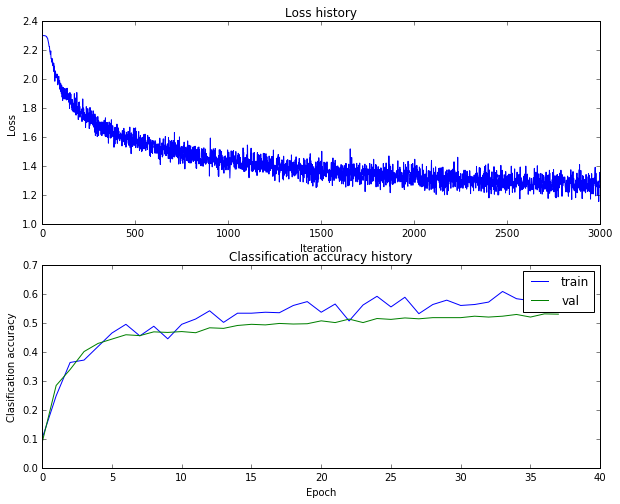

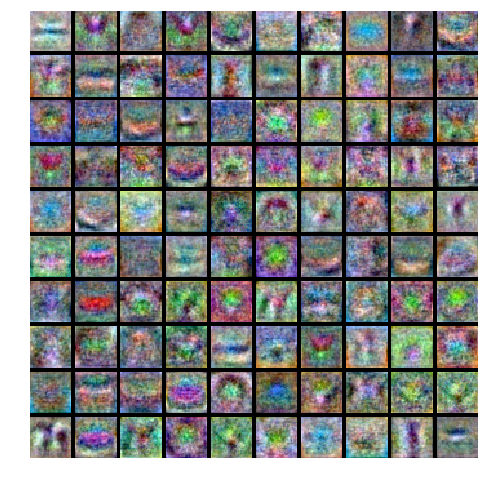

Validation accuracy:  0.532
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 5000
                           and batch size = 200
iteration 0 / 5000: loss 2.302707
iteration 100 / 5000: loss 1.932277
iteration 200 / 5000: loss 1.775864
iteration 300 / 5000: loss 1.768827
iteration 400 / 5000: loss 1.636079
iteration 500 / 5000: loss 1.603036
iteration 600 / 5000: loss 1.557649
iteration 700 / 5000: loss 1.621743
iteration 800 / 5000: loss 1.539574
iteration 900 / 5000: loss 1.496569
iteration 1000 / 5000: loss 1.415086
iteration 1100 / 5000: loss 1.500885
iteration 1200 / 5000: loss 1.360170
iteration 1300 / 5000: loss 1.399825
iteration 1400 / 5000: loss 1.504025
iteration 1500 / 5000: loss 1.358874
iteration 1600 / 5000: loss 1.233406
iteration 1700 / 5000: loss 1.315357
iteration 1800 / 5000: loss 1.302437
iteration 1900 / 5000: loss 1.231594
iteration 2000 / 5000: loss 1.237169
iterat

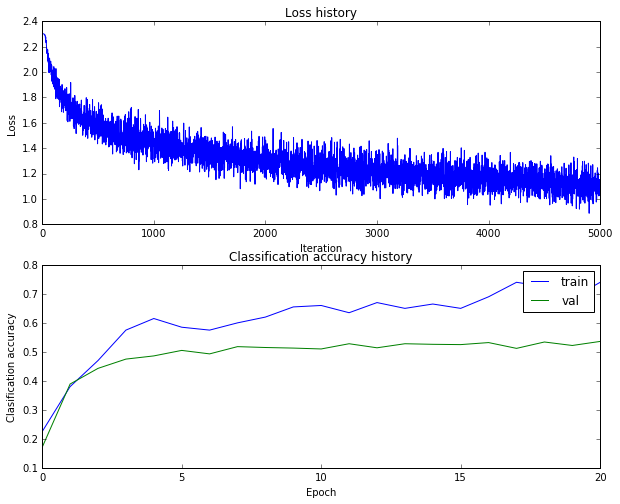

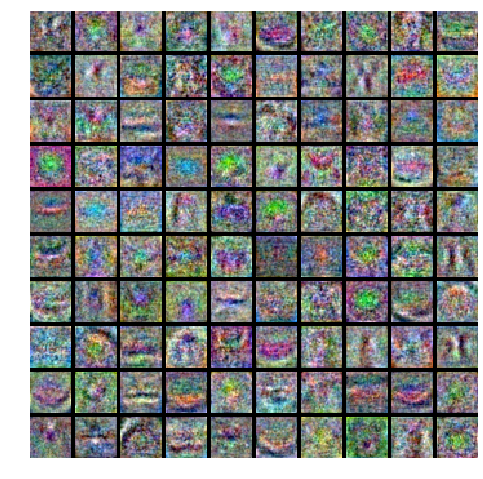

Validation accuracy:  0.528
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 5000
                           and batch size = 300
iteration 0 / 5000: loss 2.302841
iteration 100 / 5000: loss 1.985182
iteration 200 / 5000: loss 1.766121
iteration 300 / 5000: loss 1.679412
iteration 400 / 5000: loss 1.533537
iteration 500 / 5000: loss 1.568601
iteration 600 / 5000: loss 1.542308
iteration 700 / 5000: loss 1.480509
iteration 800 / 5000: loss 1.465215
iteration 900 / 5000: loss 1.407305
iteration 1000 / 5000: loss 1.436336
iteration 1100 / 5000: loss 1.444315
iteration 1200 / 5000: loss 1.438790
iteration 1300 / 5000: loss 1.269105
iteration 1400 / 5000: loss 1.412962
iteration 1500 / 5000: loss 1.440514
iteration 1600 / 5000: loss 1.373914
iteration 1700 / 5000: loss 1.420631
iteration 1800 / 5000: loss 1.336090
iteration 1900 / 5000: loss 1.336395
iteration 2000 / 5000: loss 1.245241
iterat

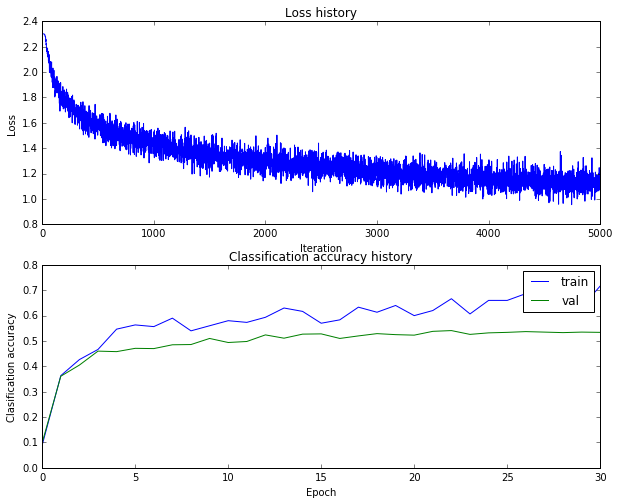

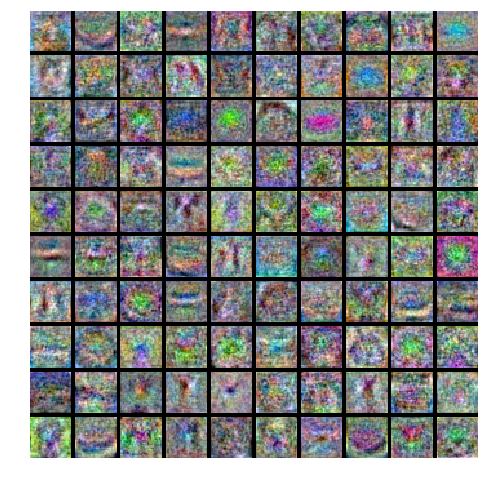

Validation accuracy:  0.538
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 5000
                           and batch size = 400
iteration 0 / 5000: loss 2.302714
iteration 100 / 5000: loss 2.026215
iteration 200 / 5000: loss 1.756145
iteration 300 / 5000: loss 1.673933
iteration 400 / 5000: loss 1.619273
iteration 500 / 5000: loss 1.565443
iteration 600 / 5000: loss 1.555879
iteration 700 / 5000: loss 1.628441
iteration 800 / 5000: loss 1.502389
iteration 900 / 5000: loss 1.504188
iteration 1000 / 5000: loss 1.377115
iteration 1100 / 5000: loss 1.431531
iteration 1200 / 5000: loss 1.325765
iteration 1300 / 5000: loss 1.347426
iteration 1400 / 5000: loss 1.356155
iteration 1500 / 5000: loss 1.348612
iteration 1600 / 5000: loss 1.275711
iteration 1700 / 5000: loss 1.294663
iteration 1800 / 5000: loss 1.259412
iteration 1900 / 5000: loss 1.230633
iteration 2000 / 5000: loss 1.299709
iterat

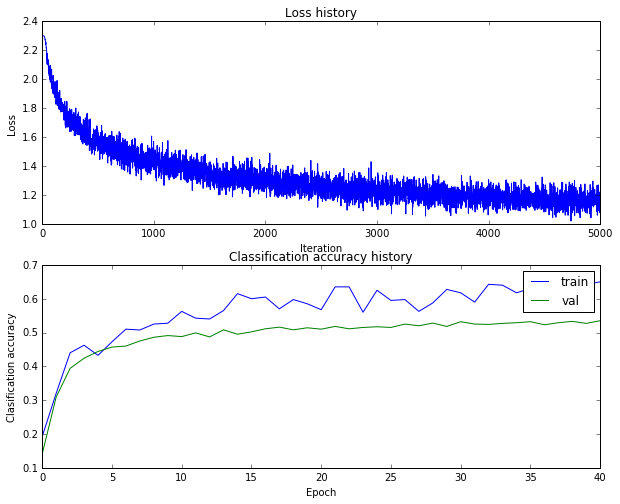

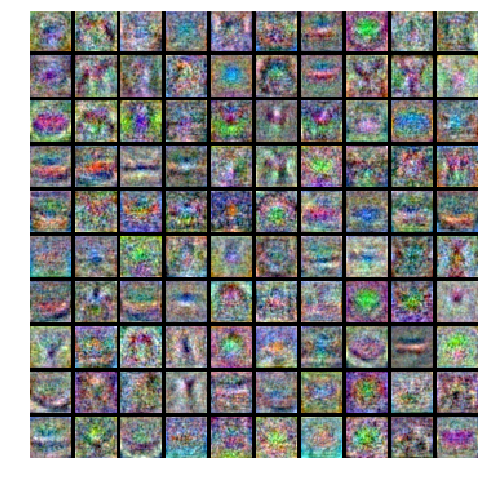

Validation accuracy:  0.532
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 5000
                           and batch size = 500
iteration 0 / 5000: loss 2.302766
iteration 100 / 5000: loss 1.924901
iteration 200 / 5000: loss 1.772945
iteration 300 / 5000: loss 1.732788
iteration 400 / 5000: loss 1.583195
iteration 500 / 5000: loss 1.549356
iteration 600 / 5000: loss 1.572035
iteration 700 / 5000: loss 1.493757
iteration 800 / 5000: loss 1.340830
iteration 900 / 5000: loss 1.357323
iteration 1000 / 5000: loss 1.401290
iteration 1100 / 5000: loss 1.393892
iteration 1200 / 5000: loss 1.427038
iteration 1300 / 5000: loss 1.354326
iteration 1400 / 5000: loss 1.351104
iteration 1500 / 5000: loss 1.429659
iteration 1600 / 5000: loss 1.370629
iteration 1700 / 5000: loss 1.378700
iteration 1800 / 5000: loss 1.370559
iteration 1900 / 5000: loss 1.389046
iteration 2000 / 5000: loss 1.365061
iterat

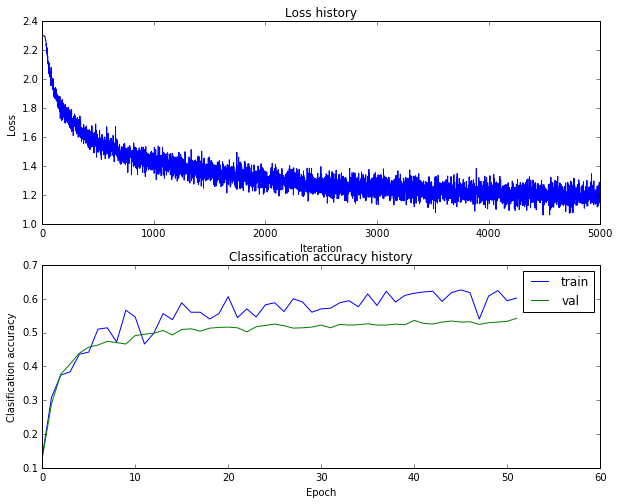

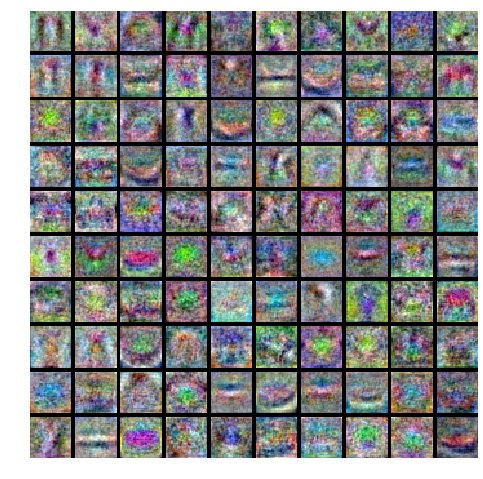

Validation accuracy:  0.544
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 5000
                           and batch size = 600
iteration 0 / 5000: loss 2.302758
iteration 100 / 5000: loss 1.928027
iteration 200 / 5000: loss 1.787411
iteration 300 / 5000: loss 1.702922
iteration 400 / 5000: loss 1.603998
iteration 500 / 5000: loss 1.620985
iteration 600 / 5000: loss 1.530183
iteration 700 / 5000: loss 1.571993
iteration 800 / 5000: loss 1.488264
iteration 900 / 5000: loss 1.476651
iteration 1000 / 5000: loss 1.416441
iteration 1100 / 5000: loss 1.474990
iteration 1200 / 5000: loss 1.400949
iteration 1300 / 5000: loss 1.443084
iteration 1400 / 5000: loss 1.400610
iteration 1500 / 5000: loss 1.353319
iteration 1600 / 5000: loss 1.357459
iteration 1700 / 5000: loss 1.335442
iteration 1800 / 5000: loss 1.289736
iteration 1900 / 5000: loss 1.398361
iteration 2000 / 5000: loss 1.351231
iterat

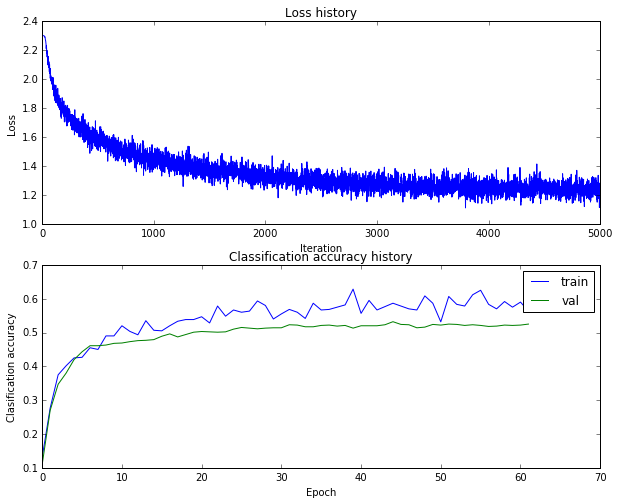

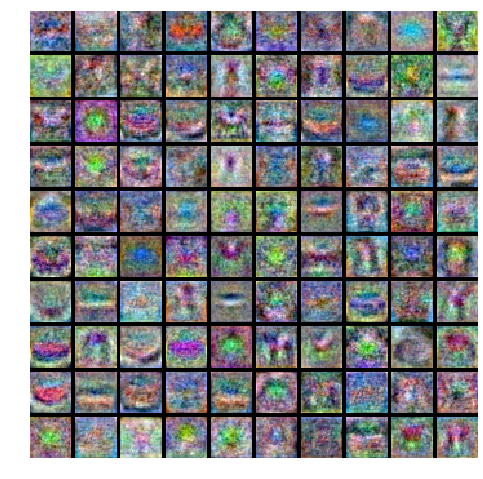

Validation accuracy:  0.526
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.302811
iteration 100 / 3000: loss 1.941713
iteration 200 / 3000: loss 1.691591
iteration 300 / 3000: loss 1.692800
iteration 400 / 3000: loss 1.679673
iteration 500 / 3000: loss 1.532627
iteration 600 / 3000: loss 1.555772
iteration 700 / 3000: loss 1.373852
iteration 800 / 3000: loss 1.444004
iteration 900 / 3000: loss 1.427489
iteration 1000 / 3000: loss 1.399743
iteration 1100 / 3000: loss 1.301119
iteration 1200 / 3000: loss 1.424603
iteration 1300 / 3000: loss 1.331052
iteration 1400 / 3000: loss 1.427091
iteration 1500 / 3000: loss 1.359657
iteration 1600 / 3000: loss 1.314774
iteration 1700 / 3000: loss 1.277440
iteration 1800 / 3000: loss 1.219873
iteration 1900 / 3000: loss 1.288279
iteration 2000 / 3000: loss 1.258215
iterat

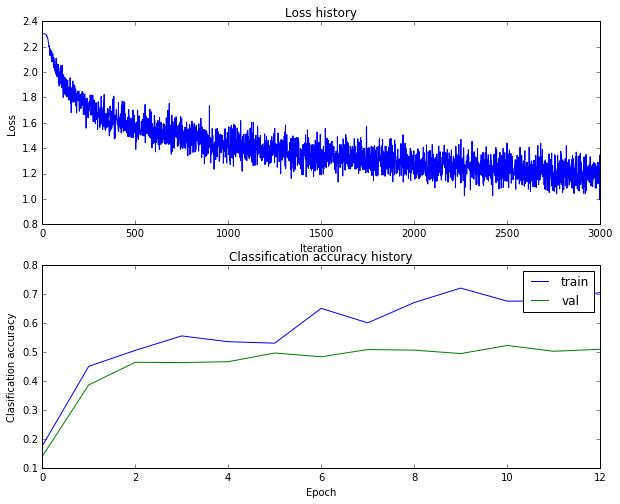

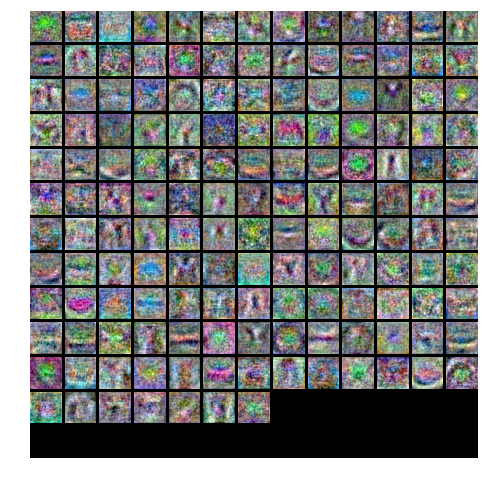

Validation accuracy:  0.525
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.302824
iteration 100 / 3000: loss 1.933769
iteration 200 / 3000: loss 1.903144
iteration 300 / 3000: loss 1.633759
iteration 400 / 3000: loss 1.680919
iteration 500 / 3000: loss 1.500918
iteration 600 / 3000: loss 1.487337
iteration 700 / 3000: loss 1.559420
iteration 800 / 3000: loss 1.438787
iteration 900 / 3000: loss 1.435650
iteration 1000 / 3000: loss 1.355890
iteration 1100 / 3000: loss 1.366084
iteration 1200 / 3000: loss 1.386823
iteration 1300 / 3000: loss 1.311520
iteration 1400 / 3000: loss 1.274902
iteration 1500 / 3000: loss 1.350452
iteration 1600 / 3000: loss 1.360812
iteration 1700 / 3000: loss 1.283421
iteration 1800 / 3000: loss 1.299359
iteration 1900 / 3000: loss 1.169677
iteration 2000 / 3000: loss 1.242974
iterat

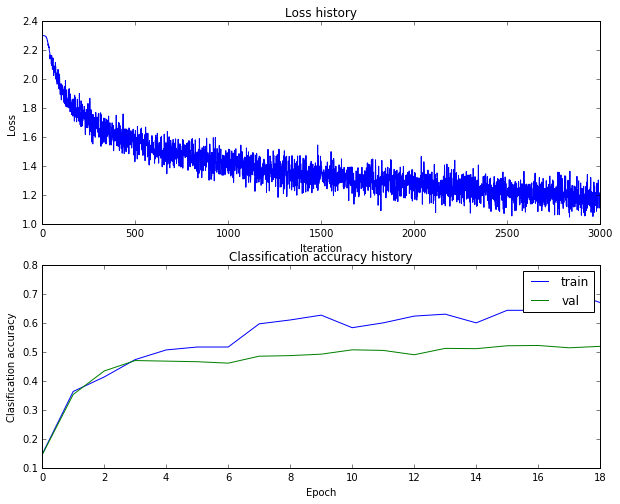

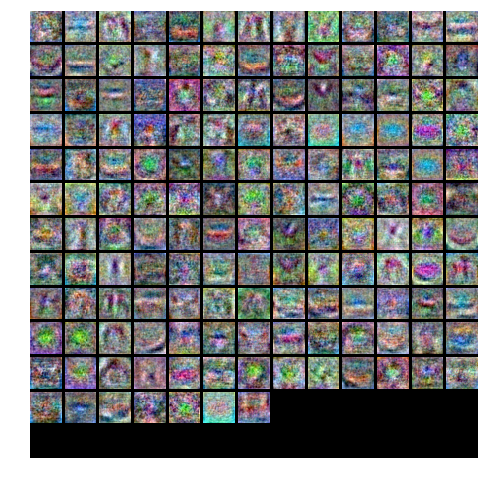

Validation accuracy:  0.533
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.302776
iteration 100 / 3000: loss 1.890455
iteration 200 / 3000: loss 1.770891
iteration 300 / 3000: loss 1.612804
iteration 400 / 3000: loss 1.588850
iteration 500 / 3000: loss 1.607707
iteration 600 / 3000: loss 1.504309
iteration 700 / 3000: loss 1.387239
iteration 800 / 3000: loss 1.503839
iteration 900 / 3000: loss 1.515184
iteration 1000 / 3000: loss 1.457314
iteration 1100 / 3000: loss 1.398618
iteration 1200 / 3000: loss 1.324669
iteration 1300 / 3000: loss 1.302144
iteration 1400 / 3000: loss 1.305823
iteration 1500 / 3000: loss 1.285217
iteration 1600 / 3000: loss 1.311305
iteration 1700 / 3000: loss 1.249140
iteration 1800 / 3000: loss 1.318836
iteration 1900 / 3000: loss 1.245533
iteration 2000 / 3000: loss 1.230319
iterat

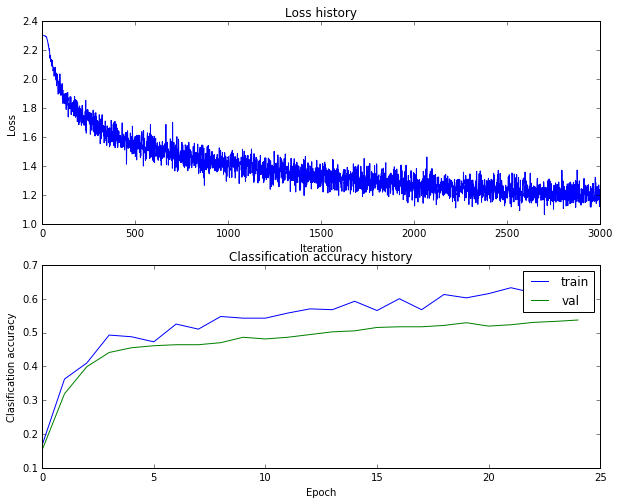

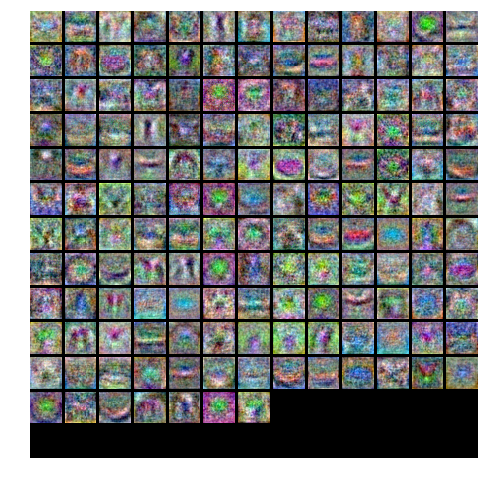

Validation accuracy:  0.542
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.302827
iteration 100 / 3000: loss 1.950374
iteration 200 / 3000: loss 1.825332
iteration 300 / 3000: loss 1.691059
iteration 400 / 3000: loss 1.607543
iteration 500 / 3000: loss 1.518539
iteration 600 / 3000: loss 1.588993
iteration 700 / 3000: loss 1.376540
iteration 800 / 3000: loss 1.525099
iteration 900 / 3000: loss 1.449446
iteration 1000 / 3000: loss 1.384183
iteration 1100 / 3000: loss 1.358349
iteration 1200 / 3000: loss 1.403024
iteration 1300 / 3000: loss 1.287732
iteration 1400 / 3000: loss 1.471087
iteration 1500 / 3000: loss 1.419936
iteration 1600 / 3000: loss 1.329049
iteration 1700 / 3000: loss 1.364573
iteration 1800 / 3000: loss 1.332651
iteration 1900 / 3000: loss 1.313601
iteration 2000 / 3000: loss 1.297338
iterat

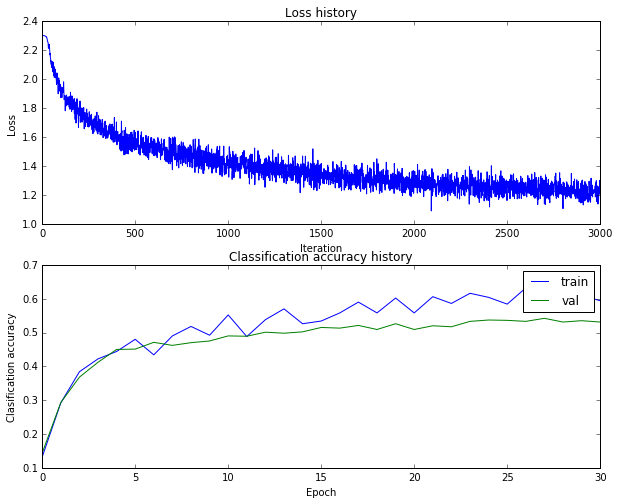

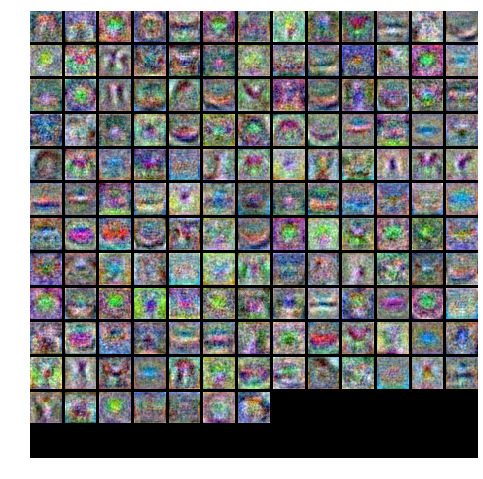

Validation accuracy:  0.53
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 3000
                           and batch size = 600
iteration 0 / 3000: loss 2.302823
iteration 100 / 3000: loss 1.907995
iteration 200 / 3000: loss 1.776404
iteration 300 / 3000: loss 1.682764
iteration 400 / 3000: loss 1.614569
iteration 500 / 3000: loss 1.557061
iteration 600 / 3000: loss 1.524627
iteration 700 / 3000: loss 1.471389
iteration 800 / 3000: loss 1.363231
iteration 900 / 3000: loss 1.407925
iteration 1000 / 3000: loss 1.406514
iteration 1100 / 3000: loss 1.454535
iteration 1200 / 3000: loss 1.355391
iteration 1300 / 3000: loss 1.452769
iteration 1400 / 3000: loss 1.409032
iteration 1500 / 3000: loss 1.276663
iteration 1600 / 3000: loss 1.315175
iteration 1700 / 3000: loss 1.359789
iteration 1800 / 3000: loss 1.340599
iteration 1900 / 3000: loss 1.324158
iteration 2000 / 3000: loss 1.331535
iterati

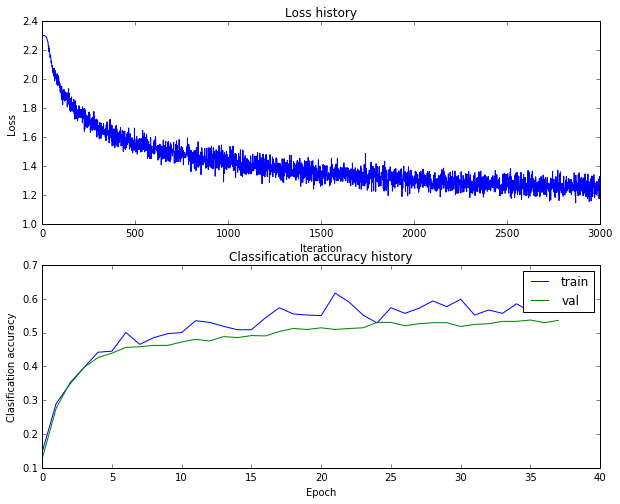

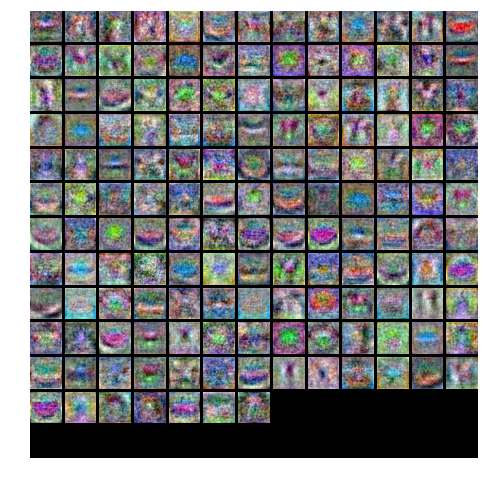

Validation accuracy:  0.535
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 5000
                           and batch size = 200
iteration 0 / 5000: loss 2.302804
iteration 100 / 5000: loss 1.844378
iteration 200 / 5000: loss 1.849150
iteration 300 / 5000: loss 1.798379
iteration 400 / 5000: loss 1.519257
iteration 500 / 5000: loss 1.558834
iteration 600 / 5000: loss 1.603196
iteration 700 / 5000: loss 1.468397
iteration 800 / 5000: loss 1.389843
iteration 900 / 5000: loss 1.433812
iteration 1000 / 5000: loss 1.456306
iteration 1100 / 5000: loss 1.558058
iteration 1200 / 5000: loss 1.426261
iteration 1300 / 5000: loss 1.411108
iteration 1400 / 5000: loss 1.200512
iteration 1500 / 5000: loss 1.267544
iteration 1600 / 5000: loss 1.294488
iteration 1700 / 5000: loss 1.378178
iteration 1800 / 5000: loss 1.323012
iteration 1900 / 5000: loss 1.441679
iteration 2000 / 5000: loss 1.169240
iterat

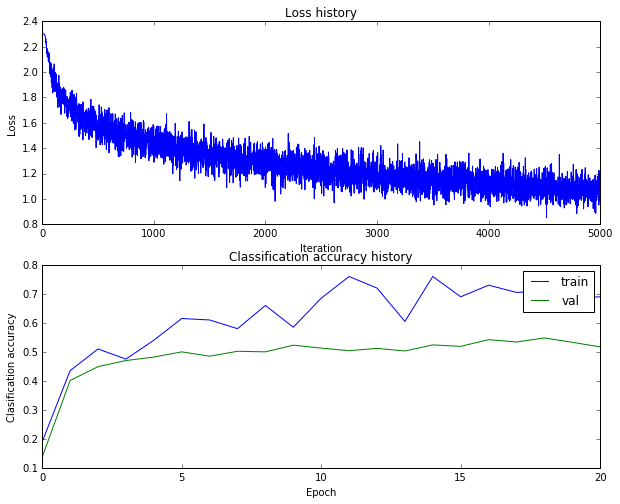

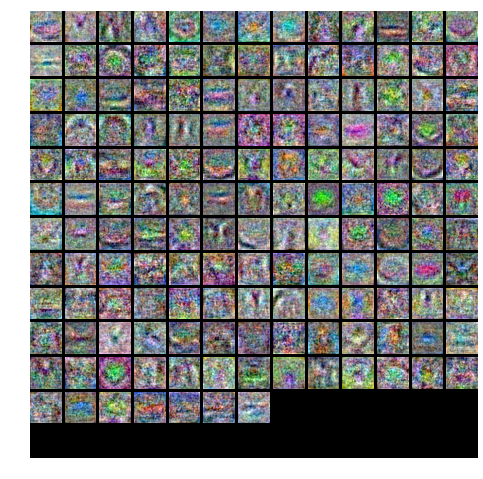

Validation accuracy:  0.539
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 5000
                           and batch size = 300
iteration 0 / 5000: loss 2.302768
iteration 100 / 5000: loss 1.972753
iteration 200 / 5000: loss 1.720161
iteration 300 / 5000: loss 1.719376
iteration 400 / 5000: loss 1.644436
iteration 500 / 5000: loss 1.636058
iteration 600 / 5000: loss 1.580164
iteration 700 / 5000: loss 1.513951
iteration 800 / 5000: loss 1.360877
iteration 900 / 5000: loss 1.425720
iteration 1000 / 5000: loss 1.403663
iteration 1100 / 5000: loss 1.384613
iteration 1200 / 5000: loss 1.378624
iteration 1300 / 5000: loss 1.338109
iteration 1400 / 5000: loss 1.355364
iteration 1500 / 5000: loss 1.384203
iteration 1600 / 5000: loss 1.286155
iteration 1700 / 5000: loss 1.333205
iteration 1800 / 5000: loss 1.405179
iteration 1900 / 5000: loss 1.234149
iteration 2000 / 5000: loss 1.157821
iterat

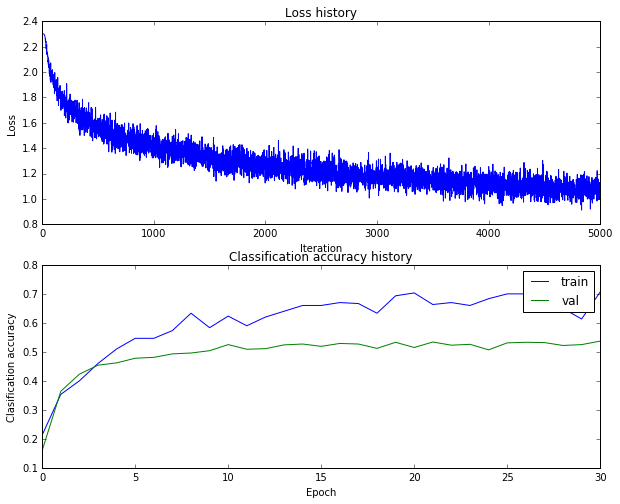

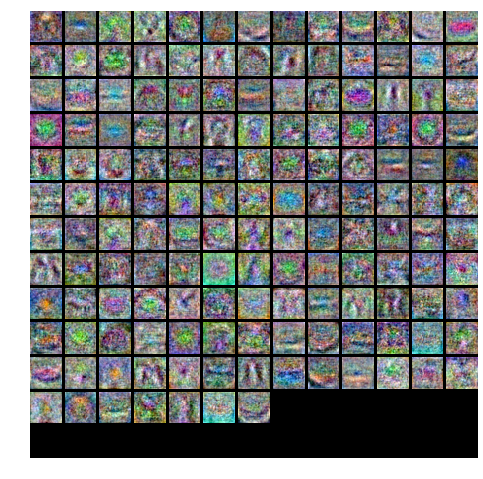

Validation accuracy:  0.524
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 5000
                           and batch size = 400
iteration 0 / 5000: loss 2.302807
iteration 100 / 5000: loss 1.924558
iteration 200 / 5000: loss 1.699431
iteration 300 / 5000: loss 1.634428
iteration 400 / 5000: loss 1.553208
iteration 500 / 5000: loss 1.510142
iteration 600 / 5000: loss 1.554387
iteration 700 / 5000: loss 1.489752
iteration 800 / 5000: loss 1.467448
iteration 900 / 5000: loss 1.476873
iteration 1000 / 5000: loss 1.418699
iteration 1100 / 5000: loss 1.436665
iteration 1200 / 5000: loss 1.450421
iteration 1300 / 5000: loss 1.358926
iteration 1400 / 5000: loss 1.394245
iteration 1500 / 5000: loss 1.340030
iteration 1600 / 5000: loss 1.421956
iteration 1700 / 5000: loss 1.285993
iteration 1800 / 5000: loss 1.385253
iteration 1900 / 5000: loss 1.257555
iteration 2000 / 5000: loss 1.233977
iterat

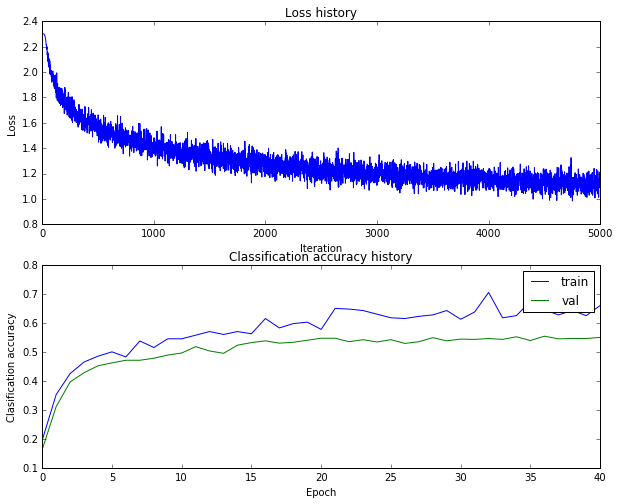

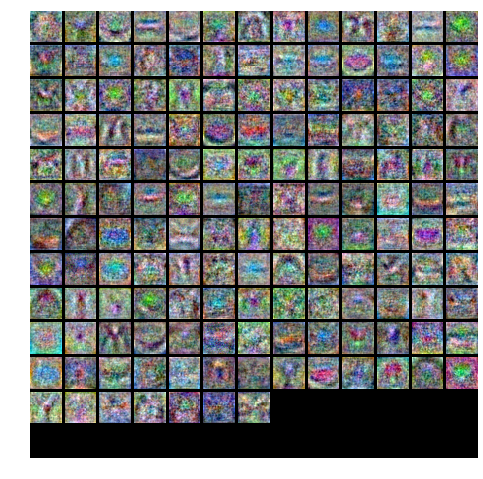

Validation accuracy:  0.547
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 5000
                           and batch size = 500
iteration 0 / 5000: loss 2.302772
iteration 100 / 5000: loss 1.849719
iteration 200 / 5000: loss 1.787882
iteration 300 / 5000: loss 1.769861
iteration 400 / 5000: loss 1.645425
iteration 500 / 5000: loss 1.541972
iteration 600 / 5000: loss 1.564839
iteration 700 / 5000: loss 1.438427
iteration 800 / 5000: loss 1.502931
iteration 900 / 5000: loss 1.280416
iteration 1000 / 5000: loss 1.334729
iteration 1100 / 5000: loss 1.392465
iteration 1200 / 5000: loss 1.302041
iteration 1300 / 5000: loss 1.361724
iteration 1400 / 5000: loss 1.366023
iteration 1500 / 5000: loss 1.323792
iteration 1600 / 5000: loss 1.299039
iteration 1700 / 5000: loss 1.367934
iteration 1800 / 5000: loss 1.269104
iteration 1900 / 5000: loss 1.236803
iteration 2000 / 5000: loss 1.384831
iterat

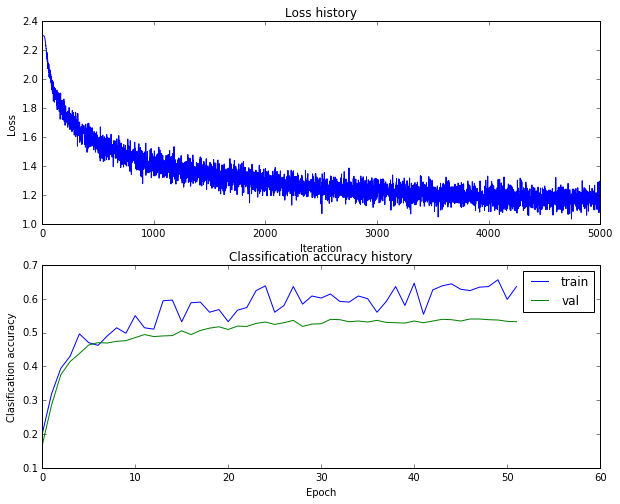

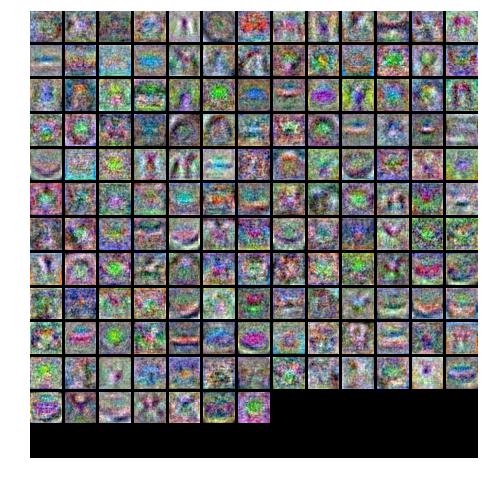

Validation accuracy:  0.526
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 5000
                           and batch size = 600
iteration 0 / 5000: loss 2.302802
iteration 100 / 5000: loss 1.924855
iteration 200 / 5000: loss 1.783949
iteration 300 / 5000: loss 1.656447
iteration 400 / 5000: loss 1.613573
iteration 500 / 5000: loss 1.532526
iteration 600 / 5000: loss 1.539686
iteration 700 / 5000: loss 1.502173
iteration 800 / 5000: loss 1.391962
iteration 900 / 5000: loss 1.400211
iteration 1000 / 5000: loss 1.465082
iteration 1100 / 5000: loss 1.338767
iteration 1200 / 5000: loss 1.399799
iteration 1300 / 5000: loss 1.386810
iteration 1400 / 5000: loss 1.351678
iteration 1500 / 5000: loss 1.335847
iteration 1600 / 5000: loss 1.347826
iteration 1700 / 5000: loss 1.313787
iteration 1800 / 5000: loss 1.323011
iteration 1900 / 5000: loss 1.347957
iteration 2000 / 5000: loss 1.331681
iterat

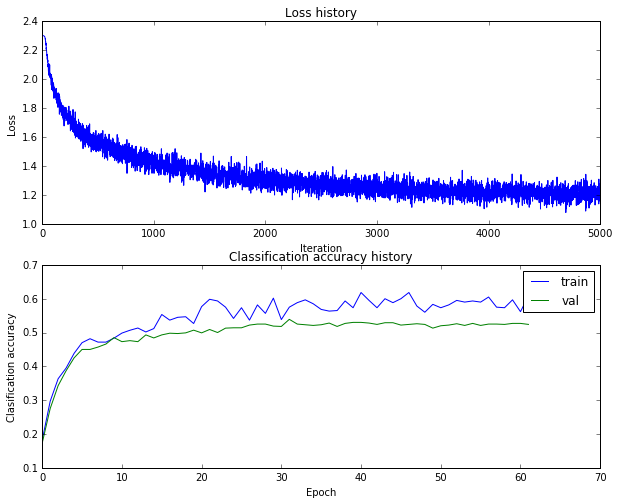

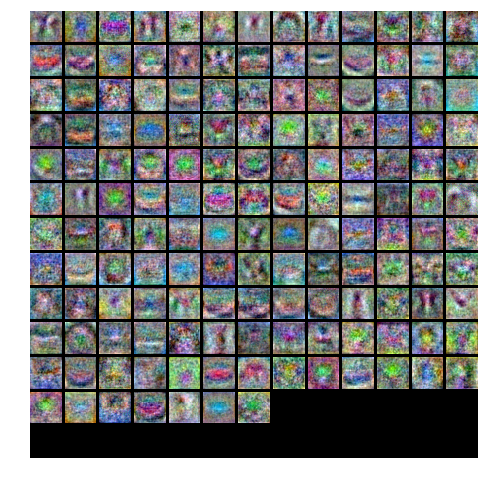

Validation accuracy:  0.522
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.302863
iteration 100 / 3000: loss 1.901591
iteration 200 / 3000: loss 1.784442
iteration 300 / 3000: loss 1.605293
iteration 400 / 3000: loss 1.613885
iteration 500 / 3000: loss 1.664039
iteration 600 / 3000: loss 1.547369
iteration 700 / 3000: loss 1.348881
iteration 800 / 3000: loss 1.481550
iteration 900 / 3000: loss 1.354193
iteration 1000 / 3000: loss 1.399374
iteration 1100 / 3000: loss 1.484482
iteration 1200 / 3000: loss 1.352177
iteration 1300 / 3000: loss 1.292569
iteration 1400 / 3000: loss 1.449397
iteration 1500 / 3000: loss 1.262496
iteration 1600 / 3000: loss 1.298471
iteration 1700 / 3000: loss 1.234599
iteration 1800 / 3000: loss 1.315610
iteration 1900 / 3000: loss 1.333928
iteration 2000 / 3000: loss 1.213660
iterat

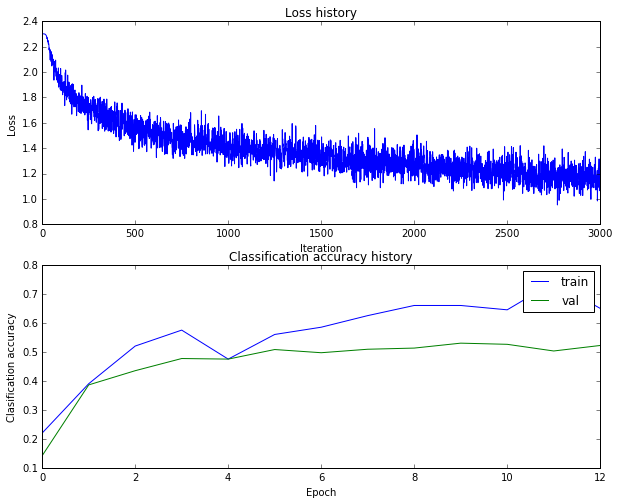

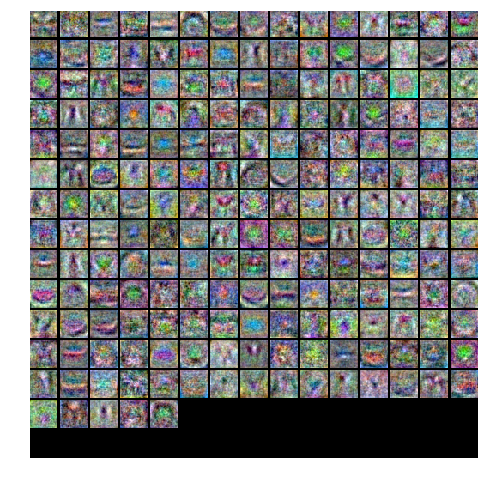

Validation accuracy:  0.542
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.302946
iteration 100 / 3000: loss 2.007540
iteration 200 / 3000: loss 1.710223
iteration 300 / 3000: loss 1.721191
iteration 400 / 3000: loss 1.608214
iteration 500 / 3000: loss 1.550677
iteration 600 / 3000: loss 1.493875
iteration 700 / 3000: loss 1.451854
iteration 800 / 3000: loss 1.518424
iteration 900 / 3000: loss 1.377713
iteration 1000 / 3000: loss 1.349705
iteration 1100 / 3000: loss 1.441656
iteration 1200 / 3000: loss 1.380996
iteration 1300 / 3000: loss 1.401810
iteration 1400 / 3000: loss 1.357559
iteration 1500 / 3000: loss 1.358324
iteration 1600 / 3000: loss 1.195976
iteration 1700 / 3000: loss 1.390922
iteration 1800 / 3000: loss 1.225794
iteration 1900 / 3000: loss 1.182020
iteration 2000 / 3000: loss 1.207174
iterat

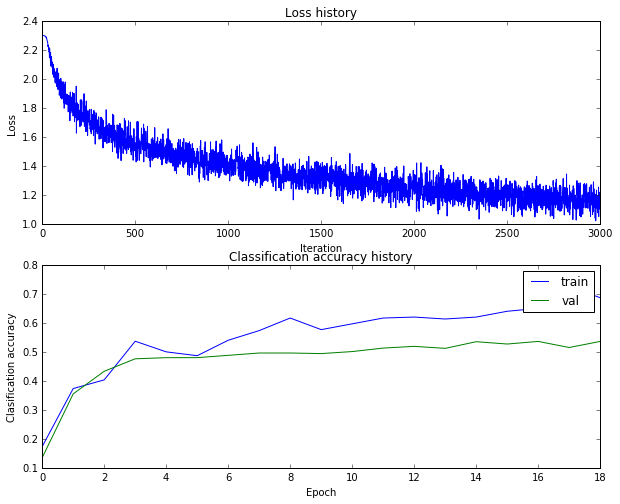

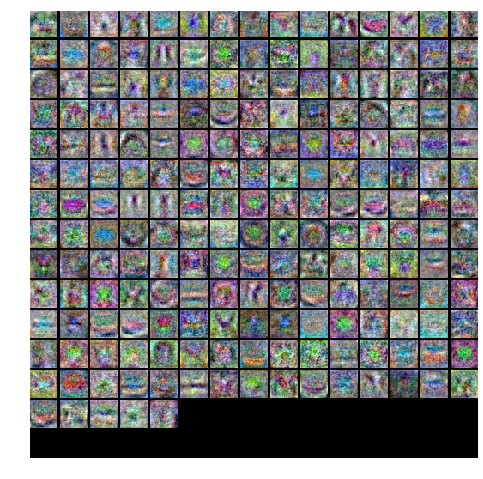

Validation accuracy:  0.54
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.302915
iteration 100 / 3000: loss 1.922593
iteration 200 / 3000: loss 1.749675
iteration 300 / 3000: loss 1.619109
iteration 400 / 3000: loss 1.594985
iteration 500 / 3000: loss 1.582895
iteration 600 / 3000: loss 1.513440
iteration 700 / 3000: loss 1.483084
iteration 800 / 3000: loss 1.394524
iteration 900 / 3000: loss 1.351443
iteration 1000 / 3000: loss 1.399484
iteration 1100 / 3000: loss 1.452104
iteration 1200 / 3000: loss 1.327578
iteration 1300 / 3000: loss 1.370459
iteration 1400 / 3000: loss 1.411986
iteration 1500 / 3000: loss 1.322407
iteration 1600 / 3000: loss 1.312640
iteration 1700 / 3000: loss 1.225842
iteration 1800 / 3000: loss 1.271963
iteration 1900 / 3000: loss 1.342089
iteration 2000 / 3000: loss 1.247948
iterati

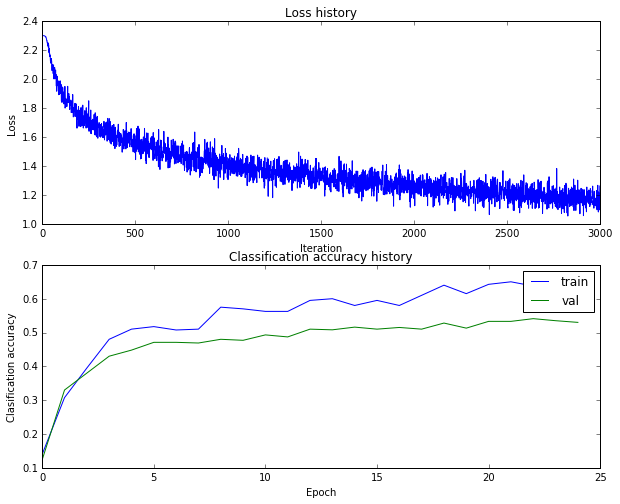

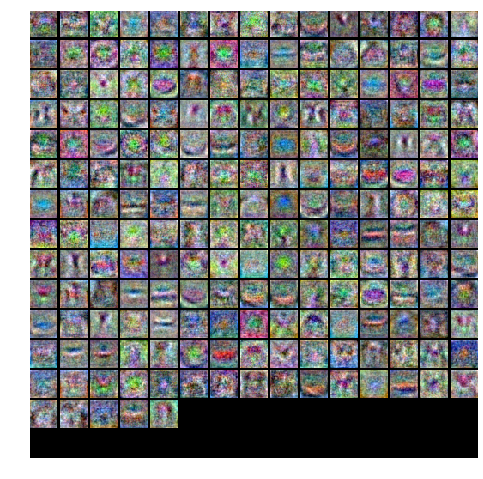

Validation accuracy:  0.529
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.302874
iteration 100 / 3000: loss 1.906034
iteration 200 / 3000: loss 1.769757
iteration 300 / 3000: loss 1.757943
iteration 400 / 3000: loss 1.604313
iteration 500 / 3000: loss 1.614069
iteration 600 / 3000: loss 1.551335
iteration 700 / 3000: loss 1.539152
iteration 800 / 3000: loss 1.466884
iteration 900 / 3000: loss 1.529010
iteration 1000 / 3000: loss 1.478733
iteration 1100 / 3000: loss 1.382354
iteration 1200 / 3000: loss 1.322618
iteration 1300 / 3000: loss 1.359278
iteration 1400 / 3000: loss 1.408668
iteration 1500 / 3000: loss 1.374515
iteration 1600 / 3000: loss 1.355558
iteration 1700 / 3000: loss 1.352795
iteration 1800 / 3000: loss 1.371246
iteration 1900 / 3000: loss 1.341255
iteration 2000 / 3000: loss 1.314044
iterat

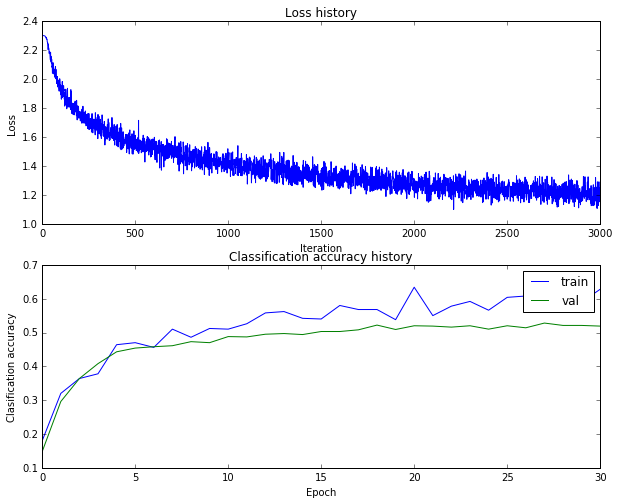

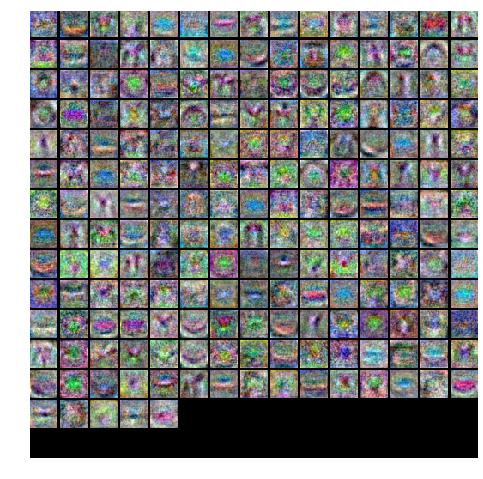

Validation accuracy:  0.53
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 3000
                           and batch size = 600
iteration 0 / 3000: loss 2.302911
iteration 100 / 3000: loss 1.936951
iteration 200 / 3000: loss 1.752267
iteration 300 / 3000: loss 1.664384
iteration 400 / 3000: loss 1.626517
iteration 500 / 3000: loss 1.598300
iteration 600 / 3000: loss 1.552917
iteration 700 / 3000: loss 1.500286
iteration 800 / 3000: loss 1.433431
iteration 900 / 3000: loss 1.388690
iteration 1000 / 3000: loss 1.420452
iteration 1100 / 3000: loss 1.462717
iteration 1200 / 3000: loss 1.408447
iteration 1300 / 3000: loss 1.424769
iteration 1400 / 3000: loss 1.319543
iteration 1500 / 3000: loss 1.320219
iteration 1600 / 3000: loss 1.473754
iteration 1700 / 3000: loss 1.385093
iteration 1800 / 3000: loss 1.366243
iteration 1900 / 3000: loss 1.350835
iteration 2000 / 3000: loss 1.270541
iterati

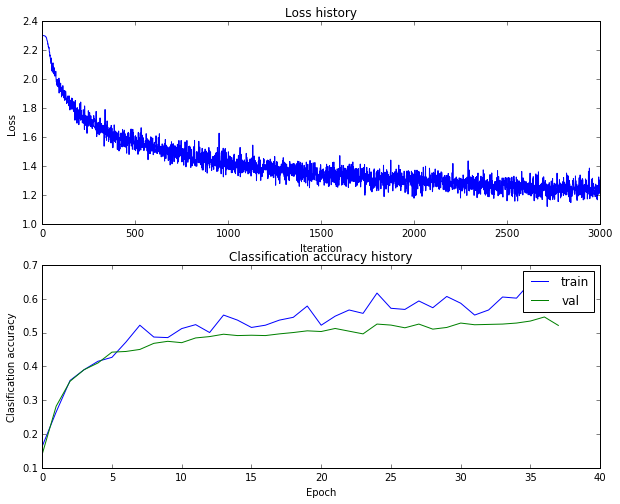

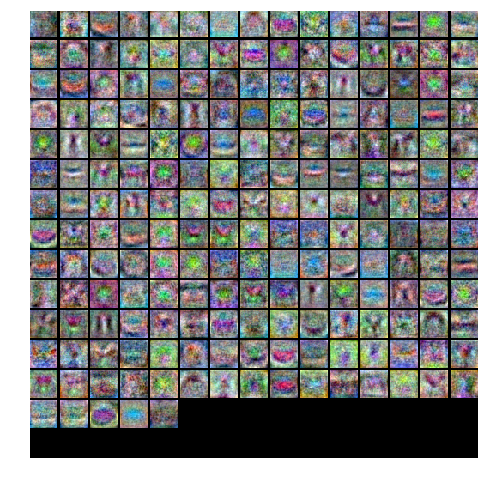

Validation accuracy:  0.527
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 5000
                           and batch size = 200
iteration 0 / 5000: loss 2.302919
iteration 100 / 5000: loss 1.985563
iteration 200 / 5000: loss 1.731890
iteration 300 / 5000: loss 1.671493
iteration 400 / 5000: loss 1.523748
iteration 500 / 5000: loss 1.605555
iteration 600 / 5000: loss 1.497666
iteration 700 / 5000: loss 1.446180
iteration 800 / 5000: loss 1.400028
iteration 900 / 5000: loss 1.498128
iteration 1000 / 5000: loss 1.484193
iteration 1100 / 5000: loss 1.331527
iteration 1200 / 5000: loss 1.401875
iteration 1300 / 5000: loss 1.356792
iteration 1400 / 5000: loss 1.389945
iteration 1500 / 5000: loss 1.418573
iteration 1600 / 5000: loss 1.412095
iteration 1700 / 5000: loss 1.222298
iteration 1800 / 5000: loss 1.288115
iteration 1900 / 5000: loss 1.261244
iteration 2000 / 5000: loss 1.376013
iterat

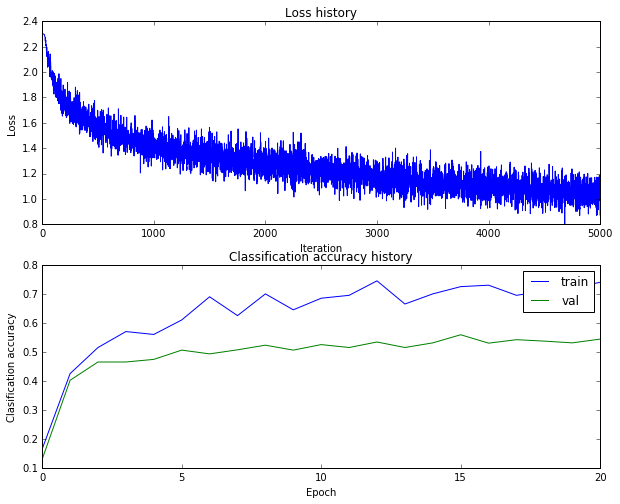

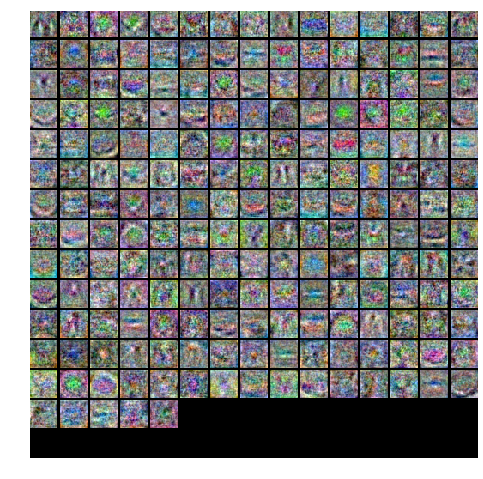

Validation accuracy:  0.546
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 5000
                           and batch size = 300
iteration 0 / 5000: loss 2.302881
iteration 100 / 5000: loss 1.875709
iteration 200 / 5000: loss 1.779430
iteration 300 / 5000: loss 1.599512
iteration 400 / 5000: loss 1.607786
iteration 500 / 5000: loss 1.556709
iteration 600 / 5000: loss 1.551187
iteration 700 / 5000: loss 1.492748
iteration 800 / 5000: loss 1.488557
iteration 900 / 5000: loss 1.375364
iteration 1000 / 5000: loss 1.247181
iteration 1100 / 5000: loss 1.422238
iteration 1200 / 5000: loss 1.301854
iteration 1300 / 5000: loss 1.365604
iteration 1400 / 5000: loss 1.290152
iteration 1500 / 5000: loss 1.271323
iteration 1600 / 5000: loss 1.299841
iteration 1700 / 5000: loss 1.295345
iteration 1800 / 5000: loss 1.285308
iteration 1900 / 5000: loss 1.223845
iteration 2000 / 5000: loss 1.261148
iterat

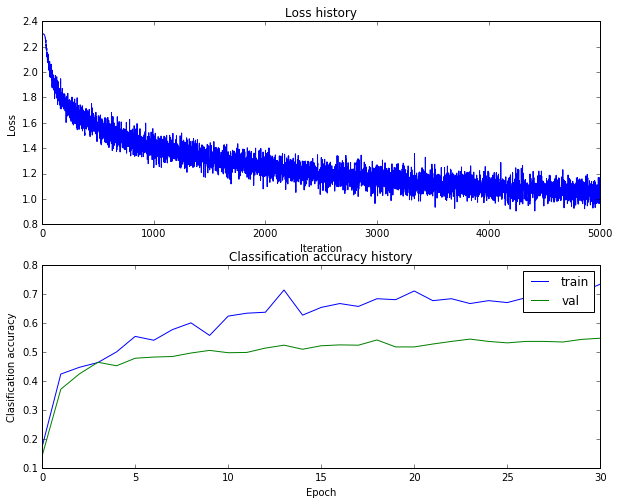

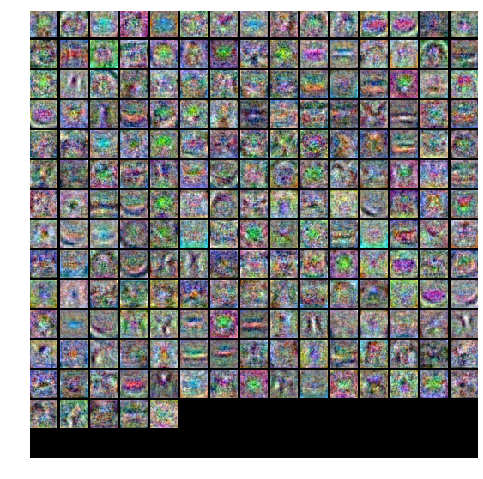

Validation accuracy:  0.539
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 5000
                           and batch size = 400
iteration 0 / 5000: loss 2.302846
iteration 100 / 5000: loss 1.867251
iteration 200 / 5000: loss 1.807423
iteration 300 / 5000: loss 1.683579
iteration 400 / 5000: loss 1.620110
iteration 500 / 5000: loss 1.577295
iteration 600 / 5000: loss 1.548379
iteration 700 / 5000: loss 1.405008
iteration 800 / 5000: loss 1.474426
iteration 900 / 5000: loss 1.435093
iteration 1000 / 5000: loss 1.386493
iteration 1100 / 5000: loss 1.371315
iteration 1200 / 5000: loss 1.375596
iteration 1300 / 5000: loss 1.372531
iteration 1400 / 5000: loss 1.377535
iteration 1500 / 5000: loss 1.286527
iteration 1600 / 5000: loss 1.400446
iteration 1700 / 5000: loss 1.280473
iteration 1800 / 5000: loss 1.273613
iteration 1900 / 5000: loss 1.270955
iteration 2000 / 5000: loss 1.260809
iterat

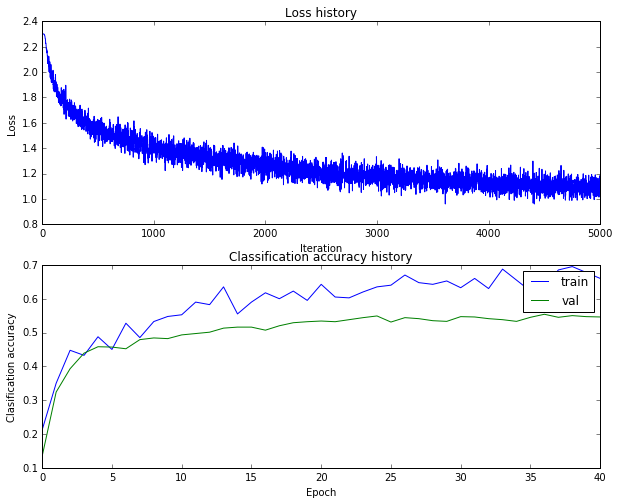

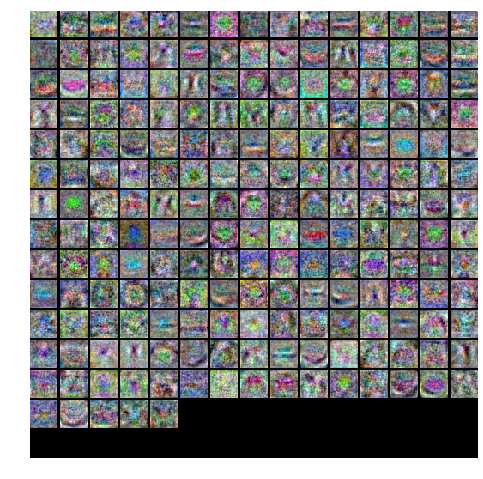

Validation accuracy:  0.543
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 5000
                           and batch size = 500
iteration 0 / 5000: loss 2.302886
iteration 100 / 5000: loss 1.961230
iteration 200 / 5000: loss 1.844185
iteration 300 / 5000: loss 1.736395
iteration 400 / 5000: loss 1.596762
iteration 500 / 5000: loss 1.524725
iteration 600 / 5000: loss 1.513107
iteration 700 / 5000: loss 1.497141
iteration 800 / 5000: loss 1.543252
iteration 900 / 5000: loss 1.453028
iteration 1000 / 5000: loss 1.426625
iteration 1100 / 5000: loss 1.315149
iteration 1200 / 5000: loss 1.350127
iteration 1300 / 5000: loss 1.340172
iteration 1400 / 5000: loss 1.371189
iteration 1500 / 5000: loss 1.301422
iteration 1600 / 5000: loss 1.275039
iteration 1700 / 5000: loss 1.316770
iteration 1800 / 5000: loss 1.315225
iteration 1900 / 5000: loss 1.271727
iteration 2000 / 5000: loss 1.233387
iterat

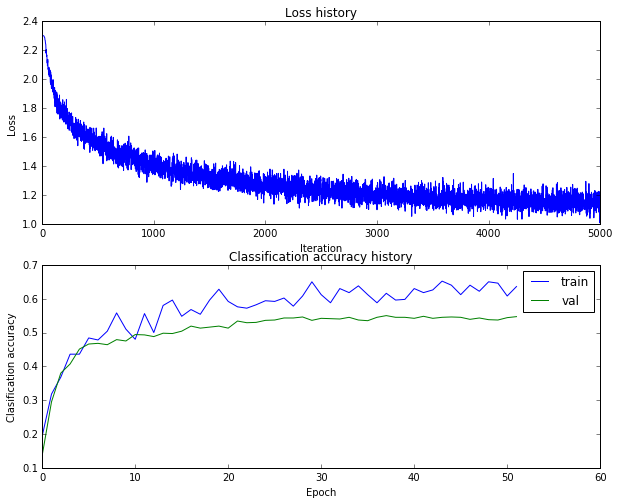

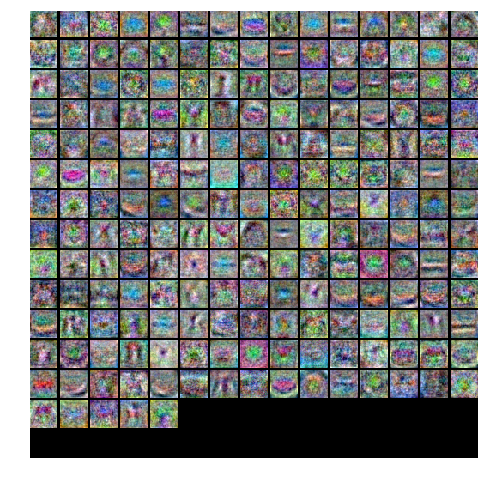

Validation accuracy:  0.55
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 5000
                           and batch size = 600
iteration 0 / 5000: loss 2.302916
iteration 100 / 5000: loss 1.924334
iteration 200 / 5000: loss 1.778393
iteration 300 / 5000: loss 1.648182
iteration 400 / 5000: loss 1.648376
iteration 500 / 5000: loss 1.524014
iteration 600 / 5000: loss 1.587394
iteration 700 / 5000: loss 1.557824
iteration 800 / 5000: loss 1.439770
iteration 900 / 5000: loss 1.426626
iteration 1000 / 5000: loss 1.442783
iteration 1100 / 5000: loss 1.353785
iteration 1200 / 5000: loss 1.439179
iteration 1300 / 5000: loss 1.401241
iteration 1400 / 5000: loss 1.387412
iteration 1500 / 5000: loss 1.311488
iteration 1600 / 5000: loss 1.321044
iteration 1700 / 5000: loss 1.351953
iteration 1800 / 5000: loss 1.324537
iteration 1900 / 5000: loss 1.279835
iteration 2000 / 5000: loss 1.288615
iterati

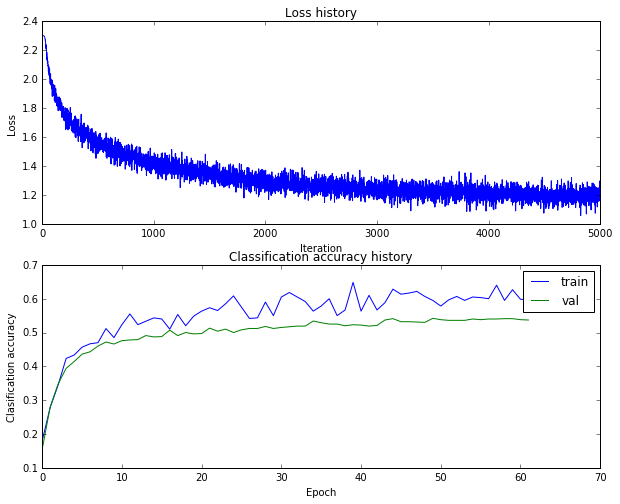

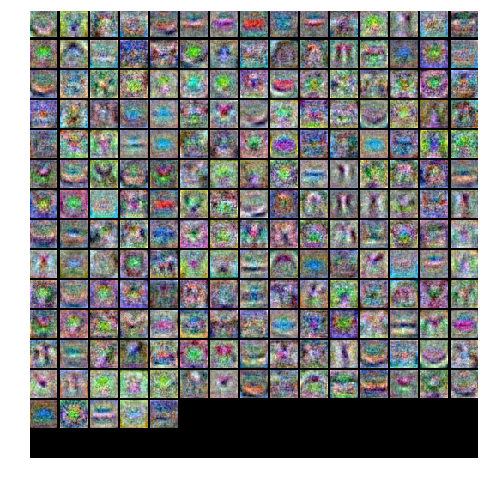

Validation accuracy:  0.539
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.302920
iteration 100 / 3000: loss 1.934882
iteration 200 / 3000: loss 1.709311
iteration 300 / 3000: loss 1.649124
iteration 400 / 3000: loss 1.690885
iteration 500 / 3000: loss 1.539084
iteration 600 / 3000: loss 1.522384
iteration 700 / 3000: loss 1.451258
iteration 800 / 3000: loss 1.653138
iteration 900 / 3000: loss 1.603259
iteration 1000 / 3000: loss 1.404713
iteration 1100 / 3000: loss 1.414728
iteration 1200 / 3000: loss 1.395023
iteration 1300 / 3000: loss 1.252520
iteration 1400 / 3000: loss 1.339817
iteration 1500 / 3000: loss 1.278214
iteration 1600 / 3000: loss 1.304046
iteration 1700 / 3000: loss 1.369661
iteration 1800 / 3000: loss 1.175437
iteration 1900 / 3000: loss 1.378015
iteration 2000 / 3000: loss 1.346026
iterat

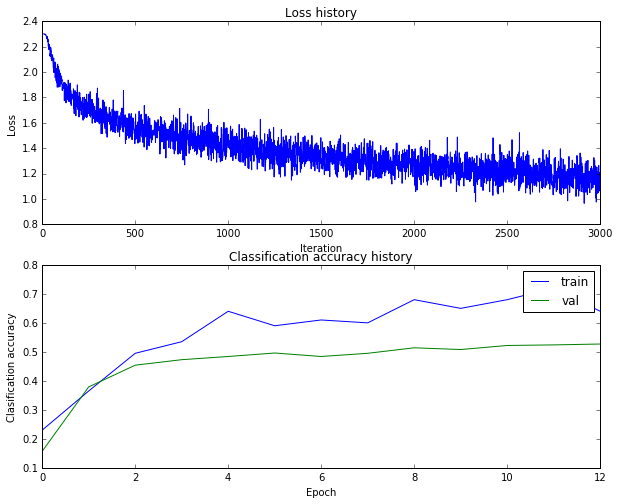

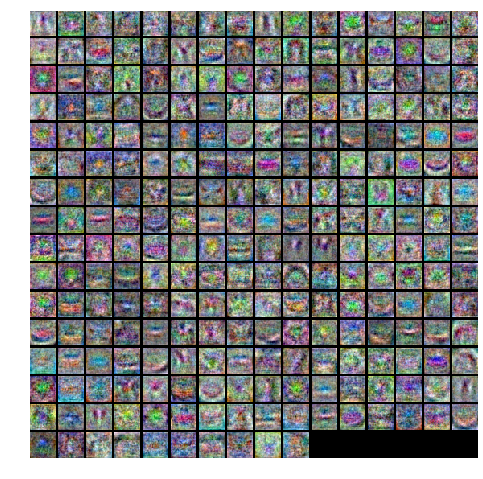

Validation accuracy:  0.518
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.302951
iteration 100 / 3000: loss 1.915226
iteration 200 / 3000: loss 1.699410
iteration 300 / 3000: loss 1.574472
iteration 400 / 3000: loss 1.568649
iteration 500 / 3000: loss 1.545928
iteration 600 / 3000: loss 1.514779
iteration 700 / 3000: loss 1.469756
iteration 800 / 3000: loss 1.544820
iteration 900 / 3000: loss 1.455976
iteration 1000 / 3000: loss 1.483696
iteration 1100 / 3000: loss 1.373738
iteration 1200 / 3000: loss 1.283241
iteration 1300 / 3000: loss 1.355754
iteration 1400 / 3000: loss 1.259299
iteration 1500 / 3000: loss 1.252036
iteration 1600 / 3000: loss 1.194424
iteration 1700 / 3000: loss 1.385916
iteration 1800 / 3000: loss 1.287628
iteration 1900 / 3000: loss 1.233697
iteration 2000 / 3000: loss 1.277296
iterat

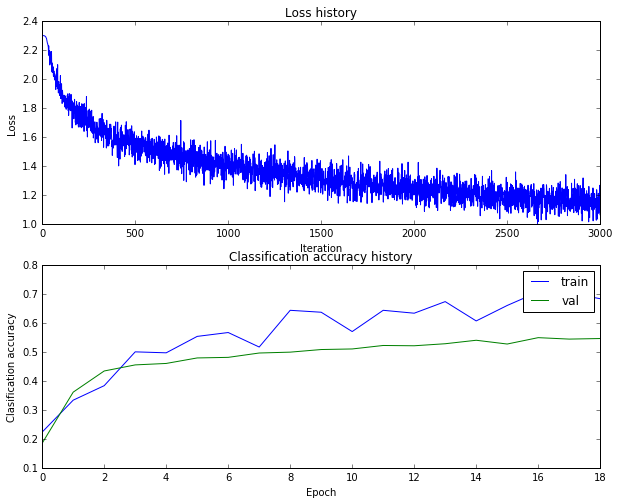

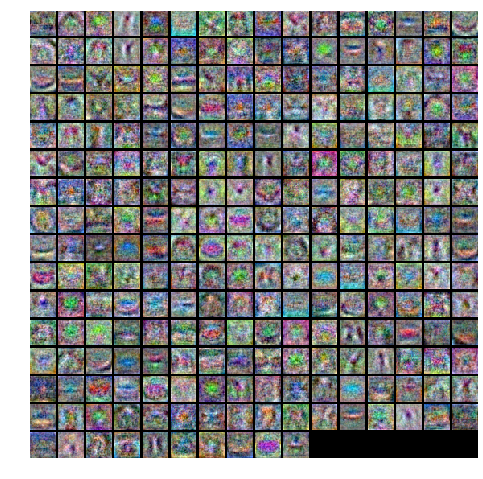

Validation accuracy:  0.548
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.302943
iteration 100 / 3000: loss 1.953516
iteration 200 / 3000: loss 1.720456
iteration 300 / 3000: loss 1.653762
iteration 400 / 3000: loss 1.481616
iteration 500 / 3000: loss 1.492391
iteration 600 / 3000: loss 1.454907
iteration 700 / 3000: loss 1.433119
iteration 800 / 3000: loss 1.484275
iteration 900 / 3000: loss 1.361230
iteration 1000 / 3000: loss 1.427640
iteration 1100 / 3000: loss 1.450207
iteration 1200 / 3000: loss 1.413043
iteration 1300 / 3000: loss 1.407731
iteration 1400 / 3000: loss 1.313399
iteration 1500 / 3000: loss 1.343819
iteration 1600 / 3000: loss 1.264584
iteration 1700 / 3000: loss 1.256100
iteration 1800 / 3000: loss 1.283904
iteration 1900 / 3000: loss 1.314098
iteration 2000 / 3000: loss 1.239575
iterat

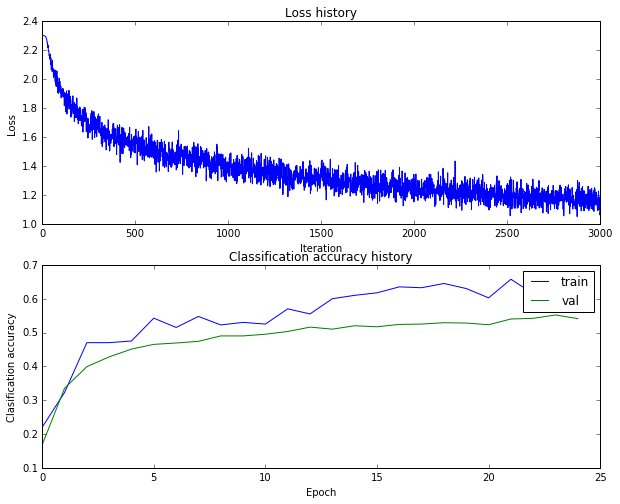

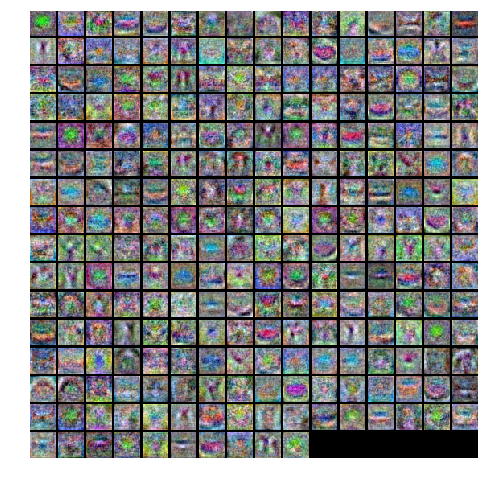

Validation accuracy:  0.544
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.302933
iteration 100 / 3000: loss 1.919810
iteration 200 / 3000: loss 1.721664
iteration 300 / 3000: loss 1.620741
iteration 400 / 3000: loss 1.696670
iteration 500 / 3000: loss 1.639339
iteration 600 / 3000: loss 1.480265
iteration 700 / 3000: loss 1.513723
iteration 800 / 3000: loss 1.479656
iteration 900 / 3000: loss 1.460548
iteration 1000 / 3000: loss 1.395104
iteration 1100 / 3000: loss 1.372472
iteration 1200 / 3000: loss 1.417212
iteration 1300 / 3000: loss 1.360827
iteration 1400 / 3000: loss 1.303749
iteration 1500 / 3000: loss 1.312825
iteration 1600 / 3000: loss 1.235756
iteration 1700 / 3000: loss 1.321980
iteration 1800 / 3000: loss 1.297837
iteration 1900 / 3000: loss 1.366440
iteration 2000 / 3000: loss 1.259353
iterat

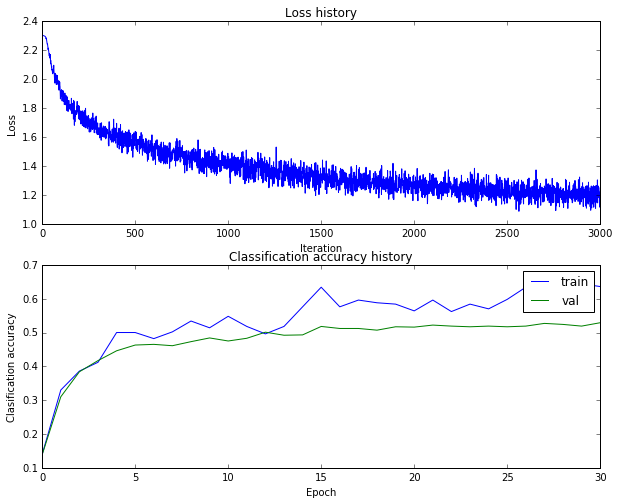

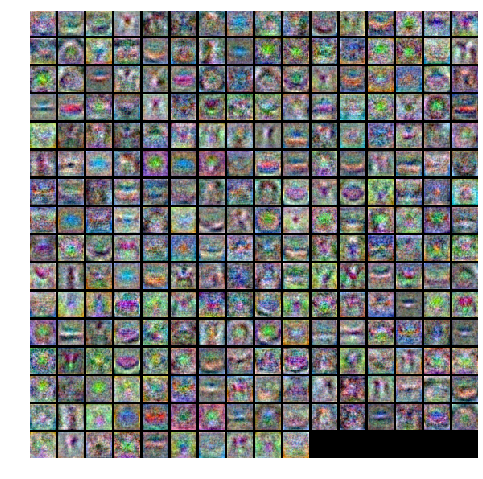

Validation accuracy:  0.531
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 3000
                           and batch size = 600
iteration 0 / 3000: loss 2.302967
iteration 100 / 3000: loss 1.933778
iteration 200 / 3000: loss 1.763865
iteration 300 / 3000: loss 1.684161
iteration 400 / 3000: loss 1.648589
iteration 500 / 3000: loss 1.524978
iteration 600 / 3000: loss 1.487643
iteration 700 / 3000: loss 1.416269
iteration 800 / 3000: loss 1.430133
iteration 900 / 3000: loss 1.421205
iteration 1000 / 3000: loss 1.429242
iteration 1100 / 3000: loss 1.448103
iteration 1200 / 3000: loss 1.409759
iteration 1300 / 3000: loss 1.387010
iteration 1400 / 3000: loss 1.350729
iteration 1500 / 3000: loss 1.311086
iteration 1600 / 3000: loss 1.282288
iteration 1700 / 3000: loss 1.334757
iteration 1800 / 3000: loss 1.326894
iteration 1900 / 3000: loss 1.316984
iteration 2000 / 3000: loss 1.246049
iterat

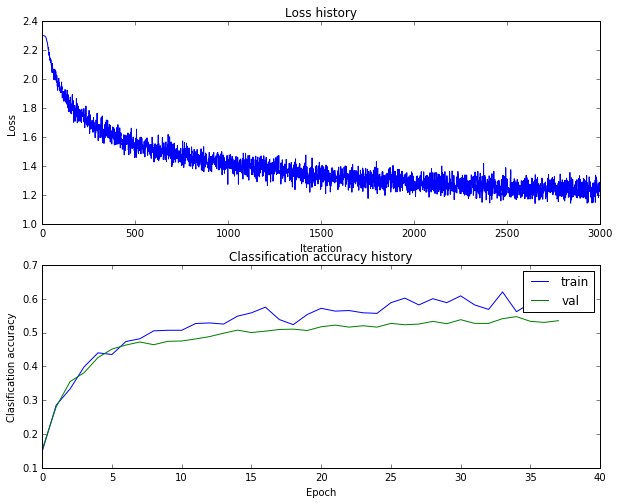

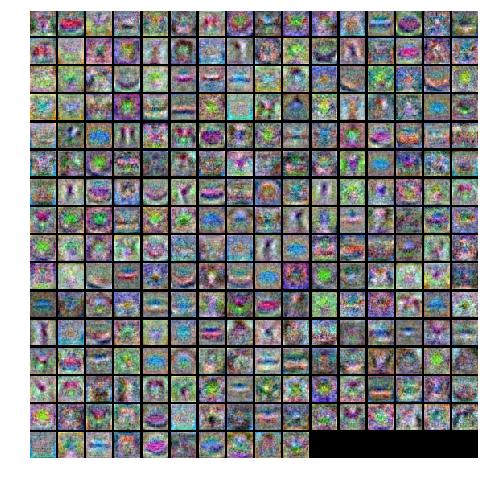

Validation accuracy:  0.536
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 5000
                           and batch size = 200
iteration 0 / 5000: loss 2.302987
iteration 100 / 5000: loss 1.937963
iteration 200 / 5000: loss 1.686617
iteration 300 / 5000: loss 1.617234
iteration 400 / 5000: loss 1.630362
iteration 500 / 5000: loss 1.598611
iteration 600 / 5000: loss 1.525962
iteration 700 / 5000: loss 1.415030
iteration 800 / 5000: loss 1.390799
iteration 900 / 5000: loss 1.517666
iteration 1000 / 5000: loss 1.416668
iteration 1100 / 5000: loss 1.230880
iteration 1200 / 5000: loss 1.249653
iteration 1300 / 5000: loss 1.304163
iteration 1400 / 5000: loss 1.317493
iteration 1500 / 5000: loss 1.250307
iteration 1600 / 5000: loss 1.374996
iteration 1700 / 5000: loss 1.273392
iteration 1800 / 5000: loss 1.146281
iteration 1900 / 5000: loss 1.298215
iteration 2000 / 5000: loss 1.310454
iterat

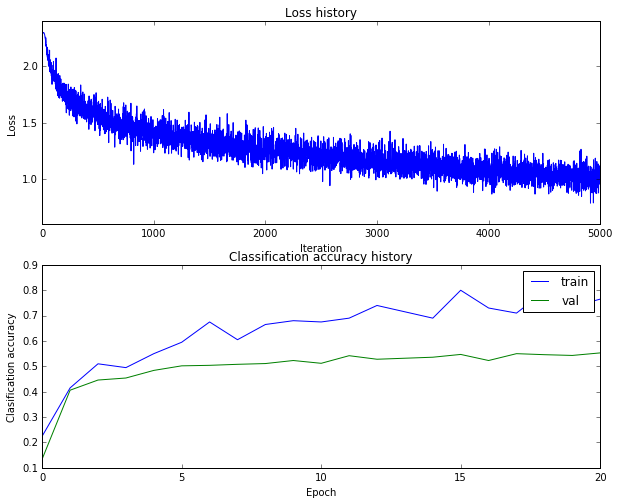

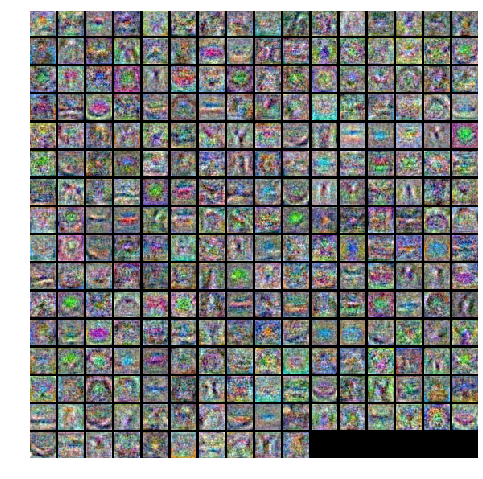

Validation accuracy:  0.534
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 5000
                           and batch size = 300
iteration 0 / 5000: loss 2.303009
iteration 100 / 5000: loss 1.890742
iteration 200 / 5000: loss 1.784524
iteration 300 / 5000: loss 1.599843
iteration 400 / 5000: loss 1.596339
iteration 500 / 5000: loss 1.572768
iteration 600 / 5000: loss 1.556273
iteration 700 / 5000: loss 1.567481
iteration 800 / 5000: loss 1.508055
iteration 900 / 5000: loss 1.342290
iteration 1000 / 5000: loss 1.367688
iteration 1100 / 5000: loss 1.436297
iteration 1200 / 5000: loss 1.366707
iteration 1300 / 5000: loss 1.385497
iteration 1400 / 5000: loss 1.351190
iteration 1500 / 5000: loss 1.342813
iteration 1600 / 5000: loss 1.284458
iteration 1700 / 5000: loss 1.319863
iteration 1800 / 5000: loss 1.220316
iteration 1900 / 5000: loss 1.274988
iteration 2000 / 5000: loss 1.244515
iterat

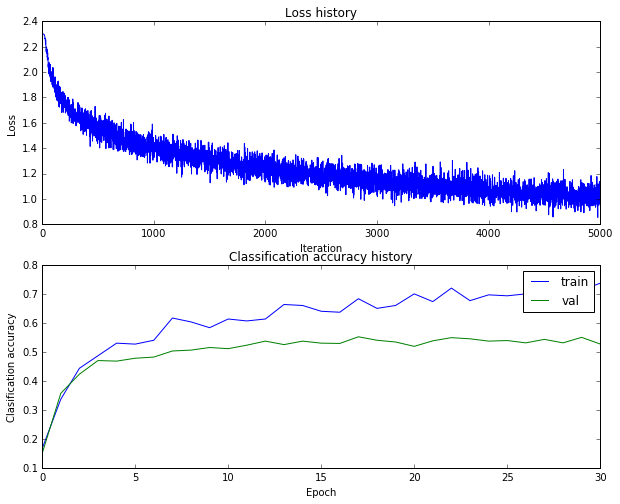

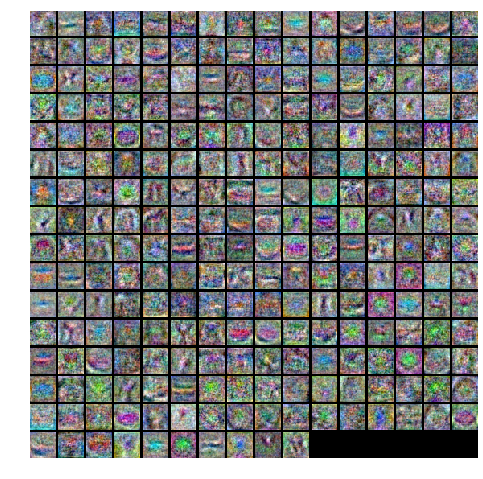

Validation accuracy:  0.539
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 5000
                           and batch size = 400
iteration 0 / 5000: loss 2.302985
iteration 100 / 5000: loss 1.999003
iteration 200 / 5000: loss 1.786656
iteration 300 / 5000: loss 1.598349
iteration 400 / 5000: loss 1.599198
iteration 500 / 5000: loss 1.518174
iteration 600 / 5000: loss 1.498579
iteration 700 / 5000: loss 1.546281
iteration 800 / 5000: loss 1.464762
iteration 900 / 5000: loss 1.456278
iteration 1000 / 5000: loss 1.403244
iteration 1100 / 5000: loss 1.425925
iteration 1200 / 5000: loss 1.302927
iteration 1300 / 5000: loss 1.355042
iteration 1400 / 5000: loss 1.307314
iteration 1500 / 5000: loss 1.329942
iteration 1600 / 5000: loss 1.273160
iteration 1700 / 5000: loss 1.157939
iteration 1800 / 5000: loss 1.221274
iteration 1900 / 5000: loss 1.311759
iteration 2000 / 5000: loss 1.280525
iterat

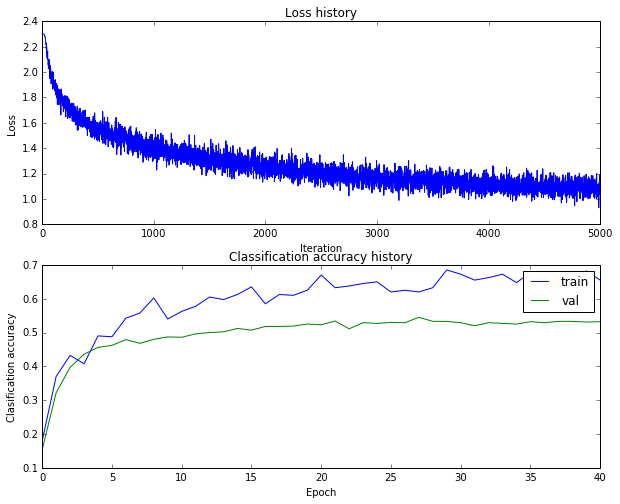

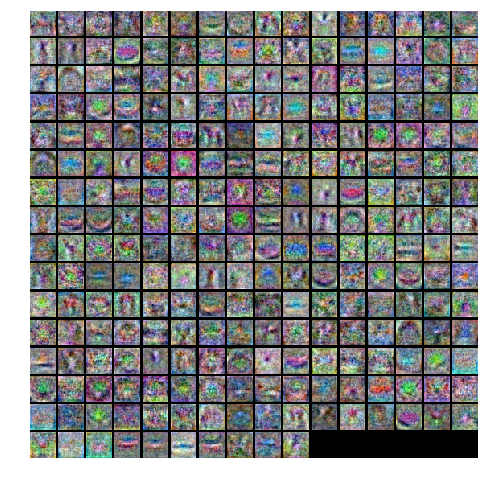

Validation accuracy:  0.532
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 5000
                           and batch size = 500
iteration 0 / 5000: loss 2.302929
iteration 100 / 5000: loss 1.925221
iteration 200 / 5000: loss 1.759398
iteration 300 / 5000: loss 1.669087
iteration 400 / 5000: loss 1.588771
iteration 500 / 5000: loss 1.528986
iteration 600 / 5000: loss 1.512347
iteration 700 / 5000: loss 1.486479
iteration 800 / 5000: loss 1.431280
iteration 900 / 5000: loss 1.429085
iteration 1000 / 5000: loss 1.402373
iteration 1100 / 5000: loss 1.389038
iteration 1200 / 5000: loss 1.366741
iteration 1300 / 5000: loss 1.312868
iteration 1400 / 5000: loss 1.326181
iteration 1500 / 5000: loss 1.341114
iteration 1600 / 5000: loss 1.309460
iteration 1700 / 5000: loss 1.240725
iteration 1800 / 5000: loss 1.267577
iteration 1900 / 5000: loss 1.203409
iteration 2000 / 5000: loss 1.184054
iterat

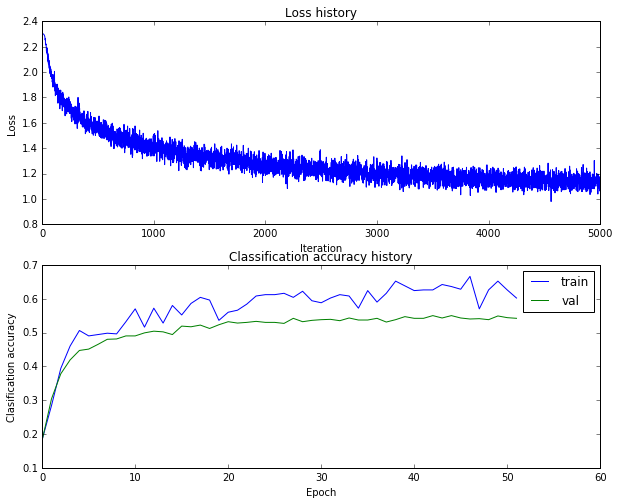

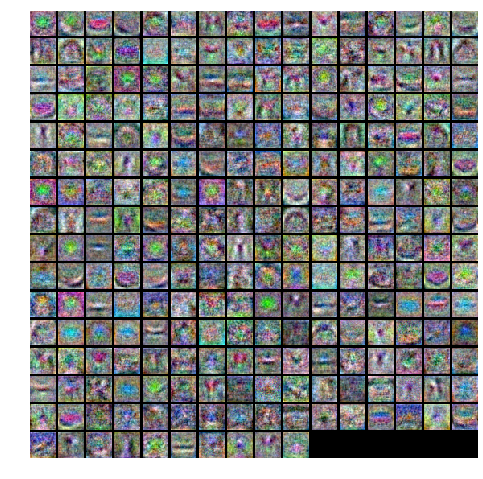

Validation accuracy:  0.541
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 5000
                           and batch size = 600
iteration 0 / 5000: loss 2.302974
iteration 100 / 5000: loss 1.939521
iteration 200 / 5000: loss 1.840229
iteration 300 / 5000: loss 1.732464
iteration 400 / 5000: loss 1.589695
iteration 500 / 5000: loss 1.525838
iteration 600 / 5000: loss 1.496139
iteration 700 / 5000: loss 1.501684
iteration 800 / 5000: loss 1.444544
iteration 900 / 5000: loss 1.470270
iteration 1000 / 5000: loss 1.418379
iteration 1100 / 5000: loss 1.422155
iteration 1200 / 5000: loss 1.421636
iteration 1300 / 5000: loss 1.349012
iteration 1400 / 5000: loss 1.311093
iteration 1500 / 5000: loss 1.359524
iteration 1600 / 5000: loss 1.353717
iteration 1700 / 5000: loss 1.367025
iteration 1800 / 5000: loss 1.334647
iteration 1900 / 5000: loss 1.317460
iteration 2000 / 5000: loss 1.275504
iterat

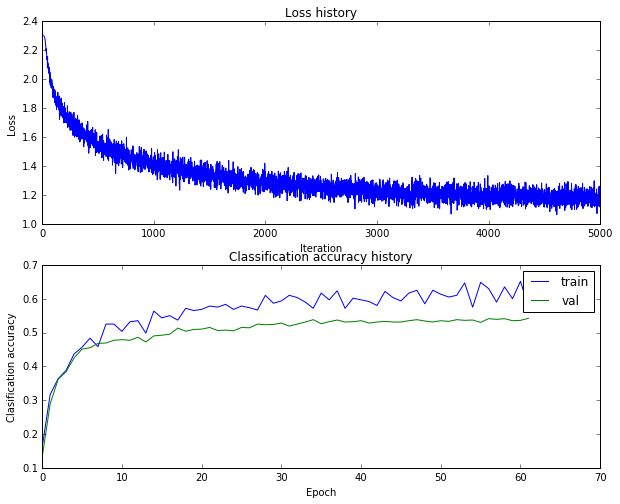

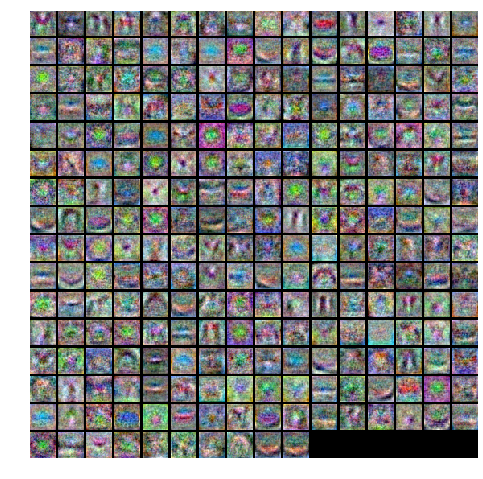

Validation accuracy:  0.54
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.303005
iteration 100 / 3000: loss 1.970871
iteration 200 / 3000: loss 1.659465
iteration 300 / 3000: loss 1.610795
iteration 400 / 3000: loss 1.585576
iteration 500 / 3000: loss 1.548832
iteration 600 / 3000: loss 1.416203
iteration 700 / 3000: loss 1.515528
iteration 800 / 3000: loss 1.395019
iteration 900 / 3000: loss 1.549287
iteration 1000 / 3000: loss 1.423572
iteration 1100 / 3000: loss 1.464699
iteration 1200 / 3000: loss 1.187369
iteration 1300 / 3000: loss 1.342500
iteration 1400 / 3000: loss 1.331948
iteration 1500 / 3000: loss 1.212666
iteration 1600 / 3000: loss 1.337083
iteration 1700 / 3000: loss 1.367197
iteration 1800 / 3000: loss 1.217773
iteration 1900 / 3000: loss 1.152652
iteration 2000 / 3000: loss 1.352283
iterati

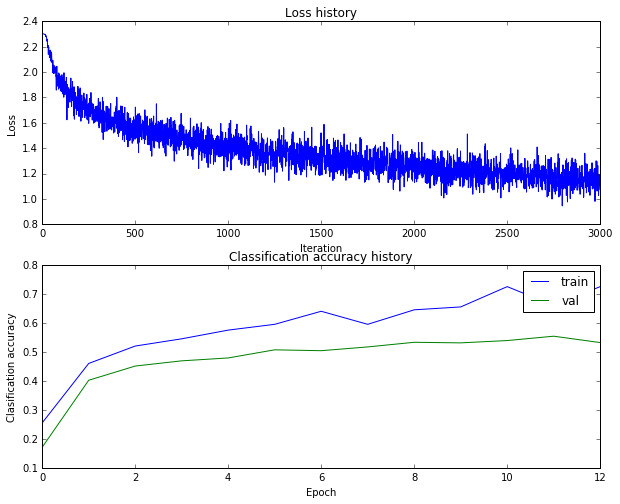

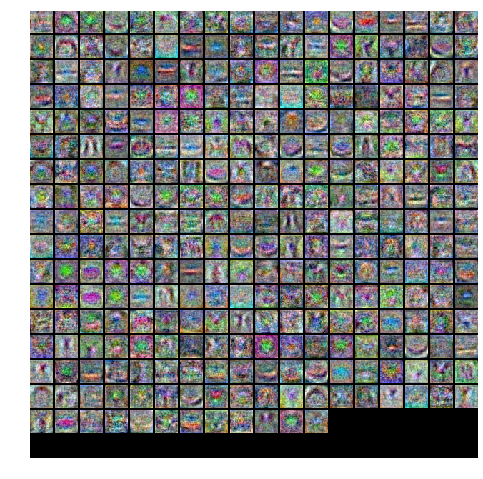

Validation accuracy:  0.537
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.303053
iteration 100 / 3000: loss 1.853439
iteration 200 / 3000: loss 1.745098
iteration 300 / 3000: loss 1.676388
iteration 400 / 3000: loss 1.664691
iteration 500 / 3000: loss 1.495226
iteration 600 / 3000: loss 1.582310
iteration 700 / 3000: loss 1.517675
iteration 800 / 3000: loss 1.449573
iteration 900 / 3000: loss 1.440298
iteration 1000 / 3000: loss 1.352950
iteration 1100 / 3000: loss 1.350539
iteration 1200 / 3000: loss 1.312946
iteration 1300 / 3000: loss 1.424907
iteration 1400 / 3000: loss 1.346793
iteration 1500 / 3000: loss 1.283201
iteration 1600 / 3000: loss 1.262610
iteration 1700 / 3000: loss 1.287907
iteration 1800 / 3000: loss 1.386431
iteration 1900 / 3000: loss 1.231303
iteration 2000 / 3000: loss 1.177675
iterat

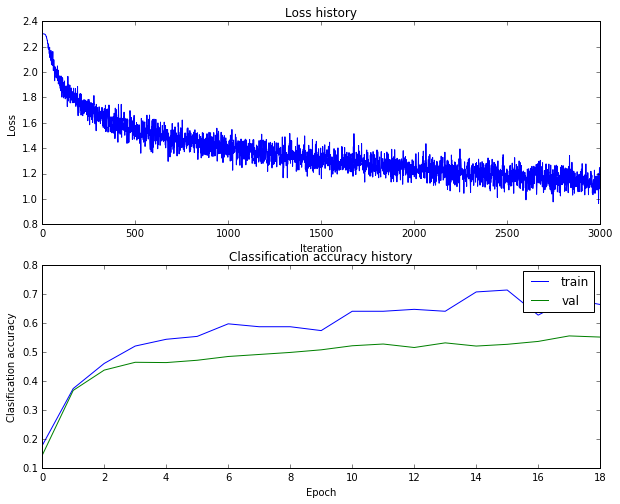

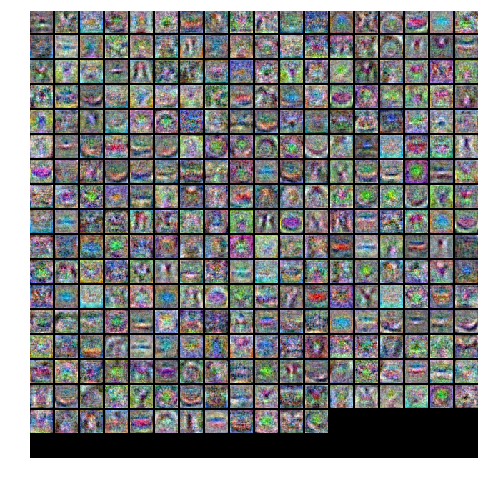

Validation accuracy:  0.538
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.303067
iteration 100 / 3000: loss 1.873579
iteration 200 / 3000: loss 1.728244
iteration 300 / 3000: loss 1.704444
iteration 400 / 3000: loss 1.631191
iteration 500 / 3000: loss 1.595053
iteration 600 / 3000: loss 1.497480
iteration 700 / 3000: loss 1.491469
iteration 800 / 3000: loss 1.340706
iteration 900 / 3000: loss 1.514084
iteration 1000 / 3000: loss 1.402639
iteration 1100 / 3000: loss 1.409275
iteration 1200 / 3000: loss 1.433456
iteration 1300 / 3000: loss 1.405965
iteration 1400 / 3000: loss 1.340962
iteration 1500 / 3000: loss 1.354722
iteration 1600 / 3000: loss 1.331226
iteration 1700 / 3000: loss 1.309243
iteration 1800 / 3000: loss 1.284853
iteration 1900 / 3000: loss 1.117872
iteration 2000 / 3000: loss 1.216320
iterat

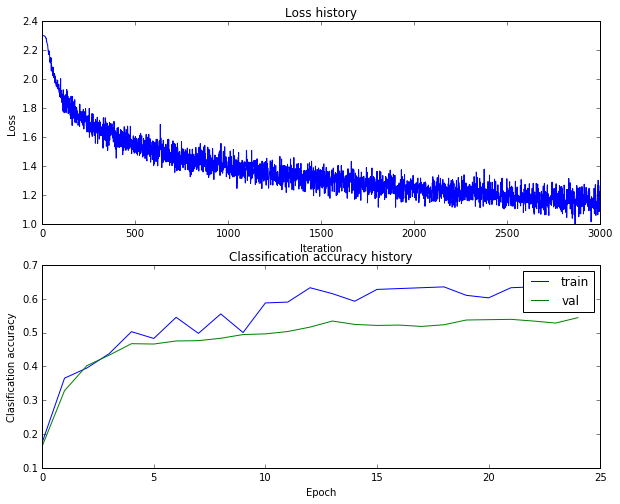

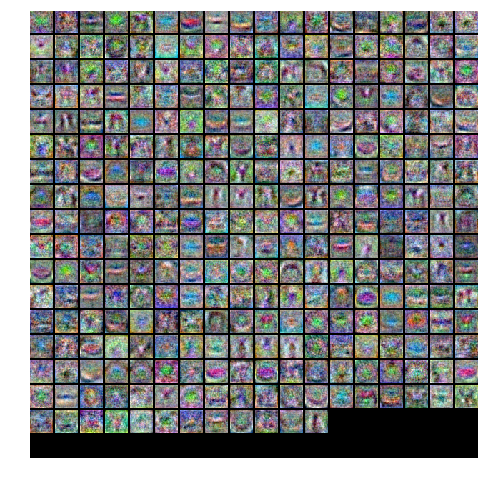

Validation accuracy:  0.533
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.303037
iteration 100 / 3000: loss 1.918859
iteration 200 / 3000: loss 1.721035
iteration 300 / 3000: loss 1.658974
iteration 400 / 3000: loss 1.586738
iteration 500 / 3000: loss 1.598110
iteration 600 / 3000: loss 1.446425
iteration 700 / 3000: loss 1.474315
iteration 800 / 3000: loss 1.419209
iteration 900 / 3000: loss 1.481821
iteration 1000 / 3000: loss 1.411816
iteration 1100 / 3000: loss 1.351052
iteration 1200 / 3000: loss 1.315684
iteration 1300 / 3000: loss 1.397187
iteration 1400 / 3000: loss 1.324126
iteration 1500 / 3000: loss 1.289952
iteration 1600 / 3000: loss 1.259444
iteration 1700 / 3000: loss 1.334192
iteration 1800 / 3000: loss 1.250759
iteration 1900 / 3000: loss 1.251336
iteration 2000 / 3000: loss 1.298072
iterat

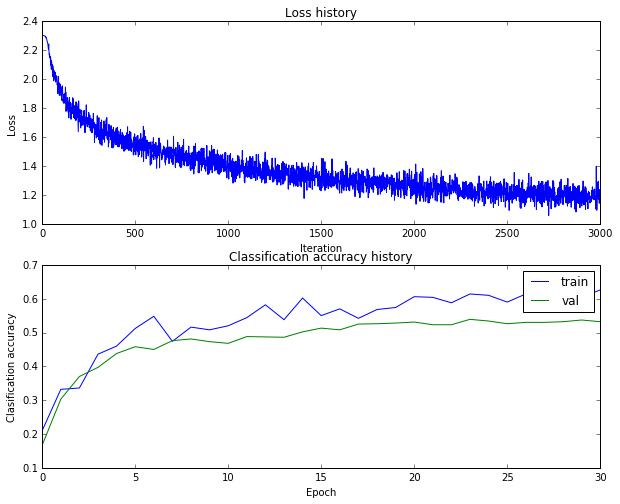

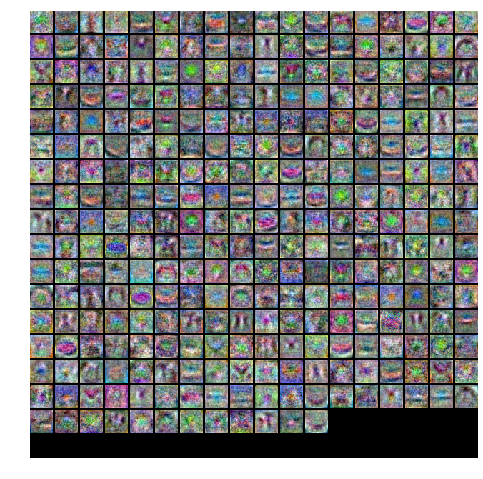

Validation accuracy:  0.535
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 3000
                           and batch size = 600
iteration 0 / 3000: loss 2.303043
iteration 100 / 3000: loss 1.858382
iteration 200 / 3000: loss 1.702821
iteration 300 / 3000: loss 1.660382
iteration 400 / 3000: loss 1.540063
iteration 500 / 3000: loss 1.543931
iteration 600 / 3000: loss 1.493061
iteration 700 / 3000: loss 1.527307
iteration 800 / 3000: loss 1.460308
iteration 900 / 3000: loss 1.421584
iteration 1000 / 3000: loss 1.449178
iteration 1100 / 3000: loss 1.394943
iteration 1200 / 3000: loss 1.398985
iteration 1300 / 3000: loss 1.473726
iteration 1400 / 3000: loss 1.351611
iteration 1500 / 3000: loss 1.374794
iteration 1600 / 3000: loss 1.319868
iteration 1700 / 3000: loss 1.252413
iteration 1800 / 3000: loss 1.337681
iteration 1900 / 3000: loss 1.325755
iteration 2000 / 3000: loss 1.208895
iterat

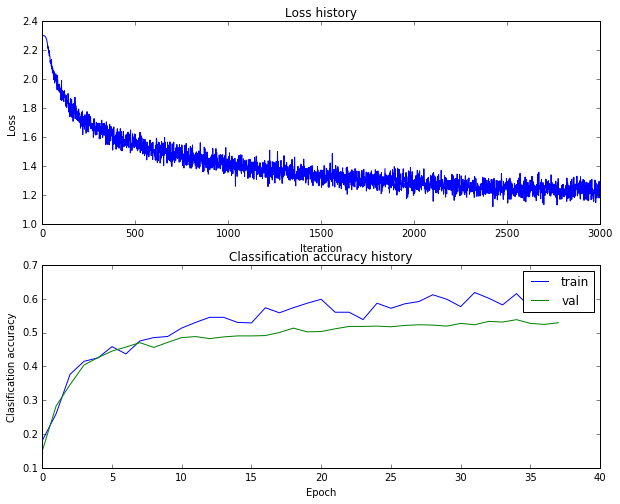

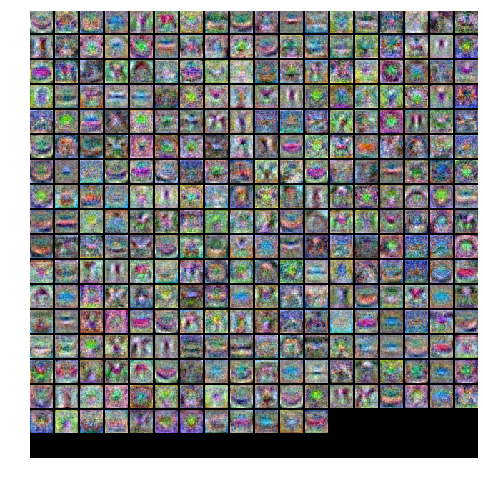

Validation accuracy:  0.533
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 5000
                           and batch size = 200
iteration 0 / 5000: loss 2.302988
iteration 100 / 5000: loss 1.852183
iteration 200 / 5000: loss 1.779741
iteration 300 / 5000: loss 1.696610
iteration 400 / 5000: loss 1.603100
iteration 500 / 5000: loss 1.590703
iteration 600 / 5000: loss 1.421599
iteration 700 / 5000: loss 1.457906
iteration 800 / 5000: loss 1.553921
iteration 900 / 5000: loss 1.470857
iteration 1000 / 5000: loss 1.508983
iteration 1100 / 5000: loss 1.280580
iteration 1200 / 5000: loss 1.438394
iteration 1300 / 5000: loss 1.330453
iteration 1400 / 5000: loss 1.361421
iteration 1500 / 5000: loss 1.425365
iteration 1600 / 5000: loss 1.231300
iteration 1700 / 5000: loss 1.286708
iteration 1800 / 5000: loss 1.199361
iteration 1900 / 5000: loss 1.220720
iteration 2000 / 5000: loss 1.261167
iterat

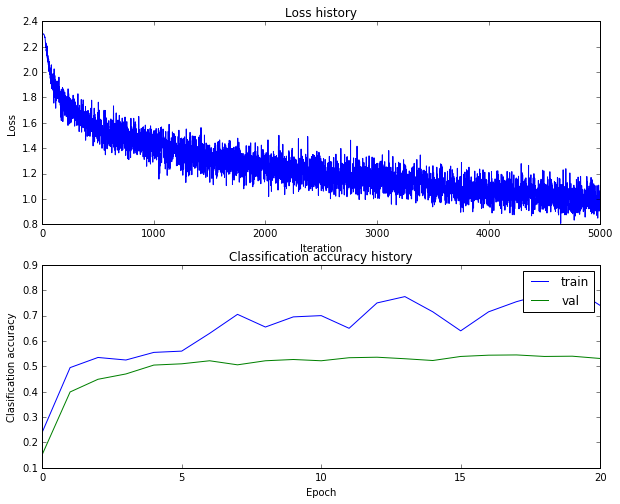

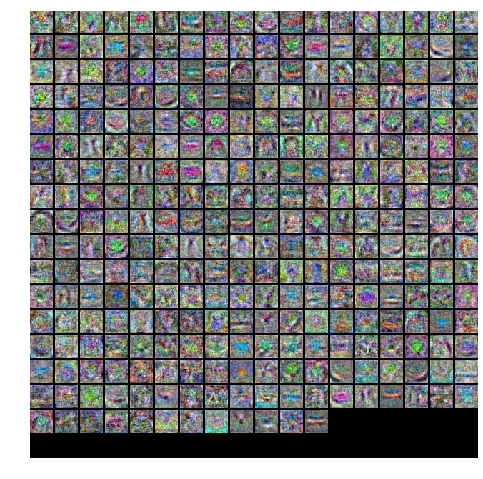

Validation accuracy:  0.543
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 5000
                           and batch size = 300
iteration 0 / 5000: loss 2.303055
iteration 100 / 5000: loss 1.865357
iteration 200 / 5000: loss 1.751208
iteration 300 / 5000: loss 1.670355
iteration 400 / 5000: loss 1.620719
iteration 500 / 5000: loss 1.537965
iteration 600 / 5000: loss 1.598476
iteration 700 / 5000: loss 1.487068
iteration 800 / 5000: loss 1.436431
iteration 900 / 5000: loss 1.369000
iteration 1000 / 5000: loss 1.514259
iteration 1100 / 5000: loss 1.373346
iteration 1200 / 5000: loss 1.233470
iteration 1300 / 5000: loss 1.290538
iteration 1400 / 5000: loss 1.265947
iteration 1500 / 5000: loss 1.398586
iteration 1600 / 5000: loss 1.213851
iteration 1700 / 5000: loss 1.280375
iteration 1800 / 5000: loss 1.164868
iteration 1900 / 5000: loss 1.234665
iteration 2000 / 5000: loss 1.205819
iterat

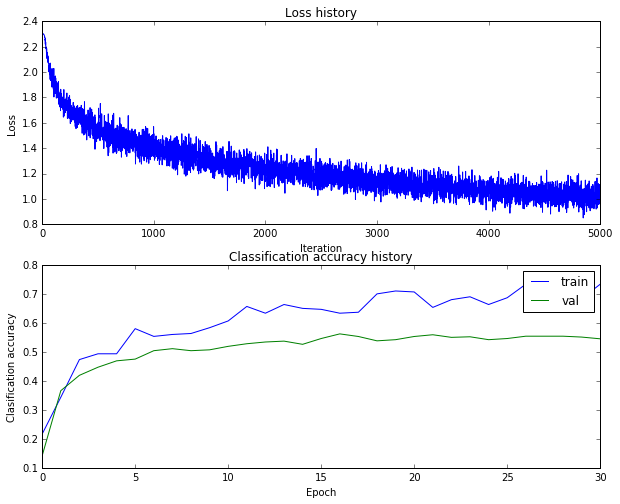

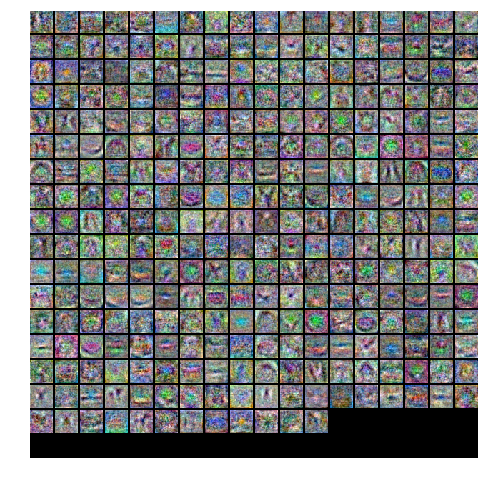

Validation accuracy:  0.56
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 5000
                           and batch size = 400
iteration 0 / 5000: loss 2.303059
iteration 100 / 5000: loss 1.949998
iteration 200 / 5000: loss 1.870516
iteration 300 / 5000: loss 1.747921
iteration 400 / 5000: loss 1.663276
iteration 500 / 5000: loss 1.527915
iteration 600 / 5000: loss 1.502606
iteration 700 / 5000: loss 1.511767
iteration 800 / 5000: loss 1.406591
iteration 900 / 5000: loss 1.394671
iteration 1000 / 5000: loss 1.429262
iteration 1100 / 5000: loss 1.426988
iteration 1200 / 5000: loss 1.286766
iteration 1300 / 5000: loss 1.361108
iteration 1400 / 5000: loss 1.338122
iteration 1500 / 5000: loss 1.359750
iteration 1600 / 5000: loss 1.335547
iteration 1700 / 5000: loss 1.243777
iteration 1800 / 5000: loss 1.350033
iteration 1900 / 5000: loss 1.308340
iteration 2000 / 5000: loss 1.294066
iterati

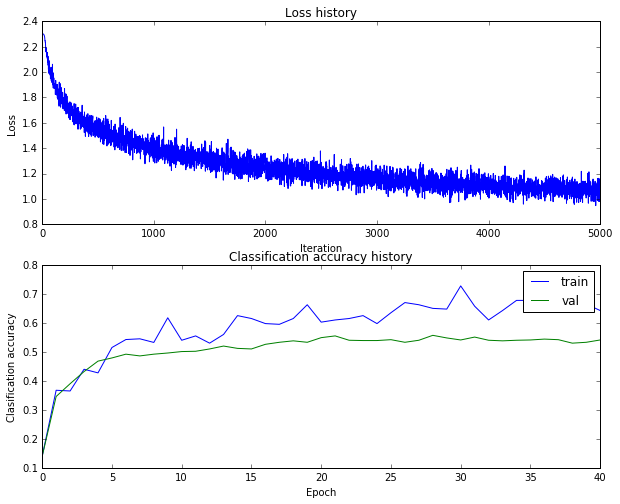

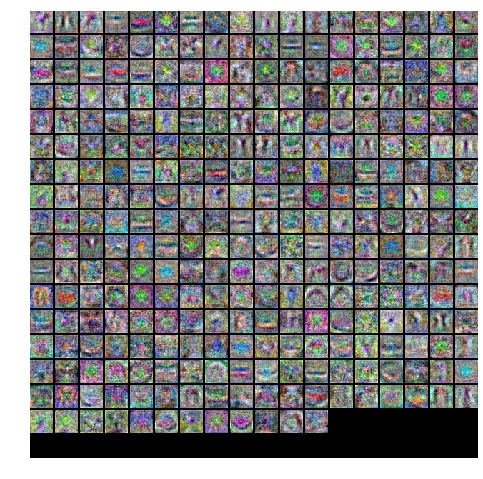

Validation accuracy:  0.548
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 5000
                           and batch size = 500
iteration 0 / 5000: loss 2.303027
iteration 100 / 5000: loss 1.892979
iteration 200 / 5000: loss 1.761281
iteration 300 / 5000: loss 1.668984
iteration 400 / 5000: loss 1.637984
iteration 500 / 5000: loss 1.557078
iteration 600 / 5000: loss 1.491376
iteration 700 / 5000: loss 1.490300
iteration 800 / 5000: loss 1.457727
iteration 900 / 5000: loss 1.372420
iteration 1000 / 5000: loss 1.385255
iteration 1100 / 5000: loss 1.324134
iteration 1200 / 5000: loss 1.242682
iteration 1300 / 5000: loss 1.297390
iteration 1400 / 5000: loss 1.307748
iteration 1500 / 5000: loss 1.379665
iteration 1600 / 5000: loss 1.421968
iteration 1700 / 5000: loss 1.273310
iteration 1800 / 5000: loss 1.287346
iteration 1900 / 5000: loss 1.303491
iteration 2000 / 5000: loss 1.195977
iterat

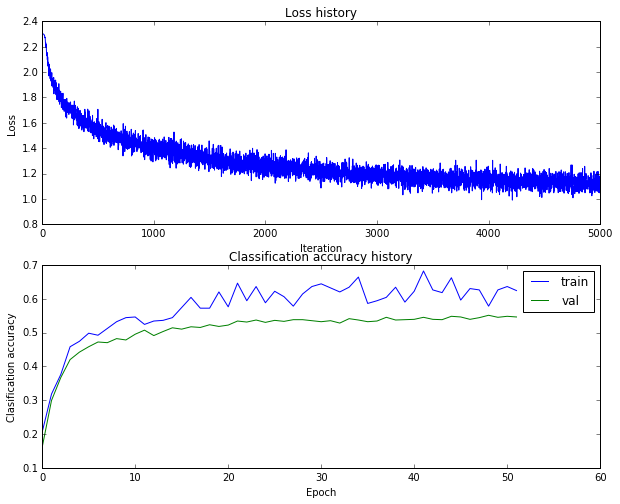

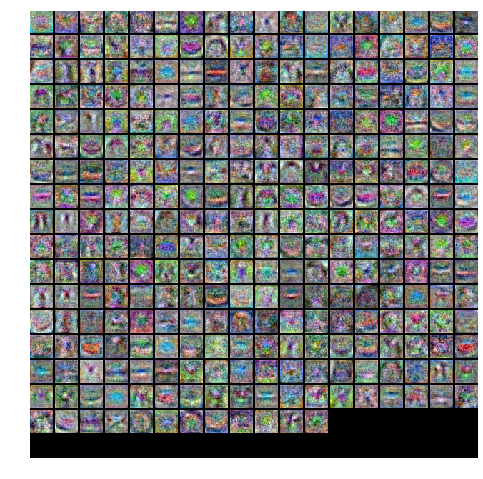

Validation accuracy:  0.544
Training learning rate = 0.0009 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 5000
                           and batch size = 600
iteration 0 / 5000: loss 2.303044
iteration 100 / 5000: loss 1.947500
iteration 200 / 5000: loss 1.682712
iteration 300 / 5000: loss 1.628305
iteration 400 / 5000: loss 1.676144
iteration 500 / 5000: loss 1.564104
iteration 600 / 5000: loss 1.492491
iteration 700 / 5000: loss 1.445777
iteration 800 / 5000: loss 1.442425
iteration 900 / 5000: loss 1.400846
iteration 1000 / 5000: loss 1.380155
iteration 1100 / 5000: loss 1.432887
iteration 1200 / 5000: loss 1.359181
iteration 1300 / 5000: loss 1.299125
iteration 1400 / 5000: loss 1.395995
iteration 1500 / 5000: loss 1.310044
iteration 1600 / 5000: loss 1.306694
iteration 1700 / 5000: loss 1.400088
iteration 1800 / 5000: loss 1.303093
iteration 1900 / 5000: loss 1.315679
iteration 2000 / 5000: loss 1.303622
iterat

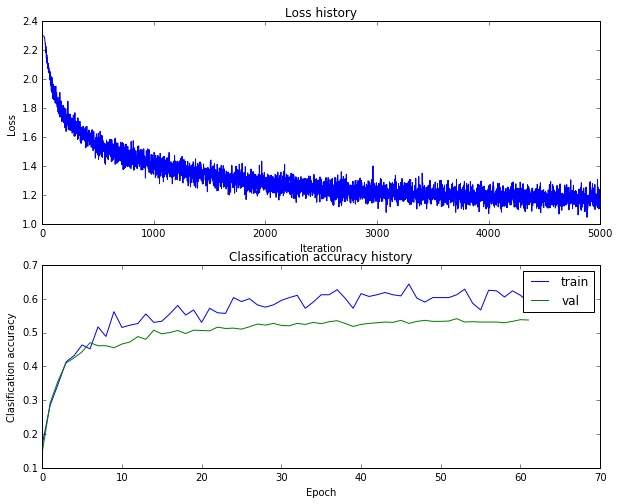

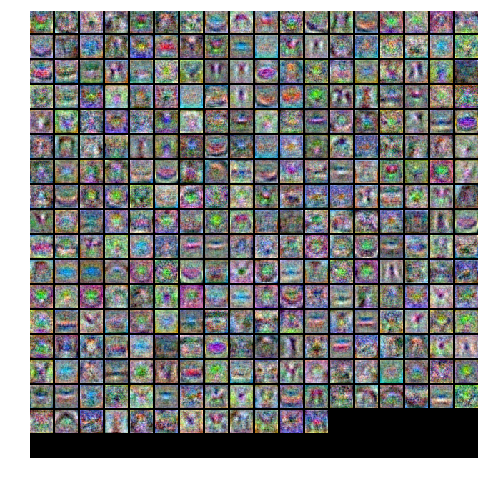

Validation accuracy:  0.536
best validation accuracy achieved during cross-validation: 0.560000


In [11]:
best_net = None # store the best model into this 

learning_rates = [9e-4, 1e-3]
regularization_strengths = [0.1]#, 0.25, 0.5, 7.5]
hidden_layer_sizes = [50, 100, 150, 200, 250, 300]
num_iterations = [3000, 5000]
batch_sizes = [200, 300, 400, 500, 600]

results = {}
best_val = -1   # The highest validation accuracy that we have seen so far.
best_net = None # The two later neural net object that achieved the highest validation rate.

#################################################################################
# TODO: Tune hyperparameters using the validation set. Store your best trained  #
# model in best_net.                                                            #
#                                                                               #
# To help debug your network, it may help to use visualizations similar to the  #
# ones we used above; these visualizations will have significant qualitative    #
# differences from the ones we saw above for the poorly tuned network.          #
#                                                                               #
# Tweaking hyperparameters by hand can be fun, but you might find it useful to  #
# write code to sweep through possible combinations of hyperparameters          #
# automatically like we did on the previous exercises.                          #
#################################################################################
for reg in regularization_strengths:
    for hidden_size in hidden_layer_sizes:
        for lr in learning_rates:
            for num_iters in num_iterations:
                for batch_size in batch_sizes:
                    print("Training learning rate = {lr} and regularization strength = {reg}\n\
                           and Size of Hidden layer = {hidden_size} and number iterations = {num_iters}\n\
                           and batch size = {batch_size}"
                          .format(lr=lr, reg=reg, hidden_size=hidden_size, 
                                  num_iters=num_iters, batch_size=batch_size))
                    net = TwoLayerNet(input_size, hidden_size, num_classes)
                    stats = net.train(X_train, y_train, X_val, y_val,
                                      num_iters=num_iters, batch_size=batch_size,
                                      learning_rate=lr, learning_rate_decay=0.95,
                                      reg=reg, verbose=True)

                    # Plot the loss function and train / validation accuracies
                    plt.subplot(2, 1, 1)
                    plt.plot(stats['loss_history'])
                    plt.title('Loss history')
                    plt.xlabel('Iteration')
                    plt.ylabel('Loss')

                    plt.subplot(2, 1, 2)
                    plt.plot(stats['train_acc_history'], label='train')
                    plt.plot(stats['val_acc_history'], label='val')
                    plt.title('Classification accuracy history')
                    plt.xlabel('Epoch')
                    plt.ylabel('Clasification accuracy')
                    plt.legend()
                    plt.show()
                    
                    show_net_weights(net)

                    y_train_pred = net.predict(X_train)
                    y_val_pred = net.predict(X_val)
                    train_accuracy = np.mean(y_train == y_train_pred)
                    val_accuracy = np.mean(y_val == y_val_pred)
                    print 'Validation accuracy: ', val_accuracy
                    results[(lr, reg, hidden_size, num_iters, batch_size)] = (train_accuracy, val_accuracy)
                    if val_accuracy > best_val:
                        best_val = val_accuracy
                        best_net = net
            
print 'best validation accuracy achieved during cross-validation: %f' % best_val
#################################################################################
#                               END OF YOUR CODE                                #
#################################################################################

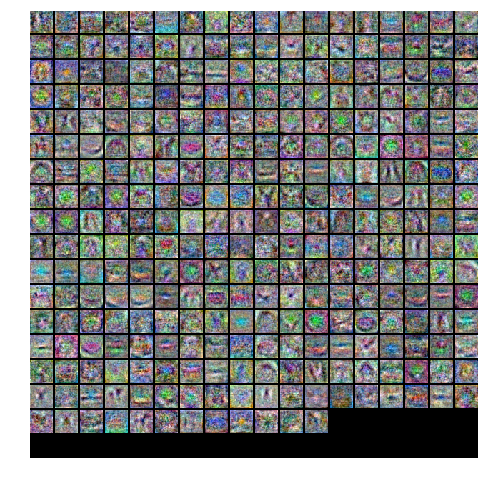

In [12]:
# visualize the weights of the best network
show_net_weights(best_net)

# Run on the test set
When you are done experimenting, you should evaluate your final trained network on the test set; you should get above 48%.

**We will give you extra bonus point for every 1% of accuracy above 52%.**

In [13]:
test_acc = (best_net.predict(X_test) == y_test).mean()
print 'Test accuracy: ', test_acc

Test accuracy:  0.545


In [14]:
results

{(0.0009, 0.1, 50, 3000, 200): (0.55316326530612248, 0.51100000000000001),
 (0.0009, 0.1, 50, 3000, 300): (0.56120408163265301, 0.504),
 (0.0009, 0.1, 50, 3000, 400): (0.56226530612244896, 0.51000000000000001),
 (0.0009, 0.1, 50, 3000, 500): (0.55177551020408167, 0.51000000000000001),
 (0.0009, 0.1, 50, 3000, 600): (0.54218367346938778, 0.51000000000000001),
 (0.0009, 0.1, 50, 5000, 200): (0.58412244897959187, 0.51900000000000002),
 (0.0009, 0.1, 50, 5000, 300): (0.58712244897959187, 0.53000000000000003),
 (0.0009, 0.1, 50, 5000, 400): (0.58038775510204077, 0.51500000000000001),
 (0.0009, 0.1, 50, 5000, 500): (0.56720408163265301, 0.51600000000000001),
 (0.0009, 0.1, 50, 5000, 600): (0.55814285714285716, 0.501),
 (0.0009, 0.1, 100, 3000, 200): (0.59359183673469385, 0.50600000000000001),
 (0.0009, 0.1, 100, 3000, 300): (0.5914081632653061, 0.50800000000000001),
 (0.0009, 0.1, 100, 3000, 400): (0.58799999999999997, 0.52500000000000002),
 (0.0009, 0.1, 100, 3000, 500): (0.5755918367346938